<a href="https://colab.research.google.com/github/lauraceciliadiazdavila/IA-LIDeSIA-Dpto-Computacion/blob/main/SMN_PS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Montar Drive y algunas librerías.

Limpieza estructural o de formato: Se chequea que estén las columnas necesarias; se crea una nueva columna FECHA_HORA ( combina la fecha y la hora en una sola columna de tipo datetime que es muy útil para trabajar luego con resampling, agrupaciones, etc); se agrega una columna ESTACION con el nombre de la hoja; se reorganizan las columnas para que sea más manejable.

¿Qué hace df_list.append(df)?

Va guardando cada df de cada hoja en una lista. Así:

Hoja 1 → DataFrame 1 → df_list[0]

Hoja 2 → DataFrame 2 → df_list[1]

Hoja 3 → …

¿Qué hace pd.concat(df_list) al final?

Une todos los DataFrame que tenías por separado (uno por estación) en un solo DataFrame gigante, llamado df_final.

Este df_final tiene todas las estaciones juntas.

Cada fila ahora tiene su FECHA_HORA, los datos climáticos y la estación a la que pertenece.

In [ ]:
# Paso 1: Librerías y conexión a Google Drive
import pandas as pd
from google.colab import drive

drive.mount('/content/drive')

# Paso 2: Ruta al archivo original (ajustala si tu archivo está en otra carpeta)
file_path = '/content/drive/MyDrive/PS/BASE_DATO/DF_SMN.xlsx'

# Paso 3: Cargar todas las hojas menos "RESUMEN"
xls = pd.ExcelFile(file_path)
sheets = [s for s in xls.sheet_names if s != 'RESUMEN']

# Paso 4: Limpiar cada hoja y acumular datos
df_list = []

for sheet in sheets:
    df = pd.read_excel(xls, sheet_name=sheet)

    expected_cols = ['FECHA', 'HORA', 'TEMP', 'HUM', 'PNM', 'DD', 'FF']
    if all(col in df.columns for col in expected_cols):
        # No eliminamos datos por ahora, para observar su distribución real
        df['FECHA_HORA'] = pd.to_datetime(df['FECHA']) + pd.to_timedelta(df['HORA'], unit='h')
        df['ESTACION'] = sheet
        df = df[['FECHA_HORA', 'TEMP', 'HUM', 'PNM', 'DD', 'FF', 'ESTACION']]
        df_list.append(df)

# Unir todo en un solo DataFrame
df_final = pd.concat(df_list, ignore_index=True)



# Paso 4: Limpiar cada hoja y acumular datos
#df_list = []

#for sheet in sheets:
    #df = pd.read_excel(xls, sheet_name=sheet)

    #expected_cols = ['FECHA', 'HORA', 'TEMP', 'HUM', 'PNM', 'DD', 'FF']
    #if all(col in df.columns for col in expected_cols):
        # Reemplazar 0.0 en HUM por NaN y eliminar filas nulas
        #df['HUM'] = df['HUM'].replace(0.0, pd.NA)
        #df = df.dropna(subset=['TEMP', 'HUM'])

        # Crear columna de fecha completa
        #df['FECHA_HORA'] = pd.to_datetime(df['FECHA']) + pd.to_timedelta(df['HORA'], unit='h')

        # Agregar nombre de estación
        #df['ESTACION'] = sheet

        # Reordenar columnas
        #df = df[['FECHA_HORA', 'TEMP', 'HUM', 'PNM', 'DD', 'FF', 'ESTACION']]
        #df_list.append(df)

# Paso 5: Unir todo en un solo DataFrame limpio
#df_final = pd.concat(df_list, ignore_index=True)

# Paso 6: Crear columnas de año y mes
#df_final['AÑO'] = df_final['FECHA_HORA'].dt.year
#df_final['MES'] = df_final['FECHA_HORA'].dt.month

# Paso 7: Agrupar por año y mes (promedios mensuales)
#df_mensual = df_final.groupby(['AÑO', 'MES']).agg({
   #'TEMP': 'mean',
    #'HUM': 'mean',
    #'PNM': 'mean',
    #'DD': 'mean',
    #'FF': 'mean'
#}).reset_index()

# Paso 8: Crear columna de PERIODO tipo datetime (ej. 2020-03)
#df_mensual['PERIODO'] = pd.to_datetime(df_mensual.rename(columns={'AÑO': 'year', 'MES': 'month'})[['year', 'month']].assign(day=1))


# Paso 9: Reordenar columnas finales
#df_mensual = df_mensual[['PERIODO', 'TEMP', 'HUM', 'PNM', 'DD', 'FF']]

# Paso 10: Guardar como nuevo archivo en tu Drive
#output_path = '/content/drive/MyDrive/SMN_CORDOBA_MENSUAL.xlsx'
#df_mensual.to_excel(output_path, index=False)

# Mostrar primeras filas
#df_mensual.head()


Mounted at /content/drive


Información de los datos del SMN

In [ ]:
# --- Chequeo para df_final (crudo, sin eliminar outliers) ---
print("===== CHEQUEO DE DF_FINAL (CRUDO) =====")
print("Dimensiones:", df_final.shape)
print("\nTipos de datos y nulos por columna:")
print(df_final.info())
print("\nValores nulos por columna:")
print(df_final.isna().sum())
print("\nPorcentaje de nulos por columna:")
print((df_final.isna().mean() * 100).round(2))
print("\nEstadísticas descriptivas:")
print(df_final.describe(include='all'))
print("\nPrimeras filas:")
print(df_final.head())

===== CHEQUEO DE DF_FINAL (CRUDO) =====
Dimensiones: (372686, 7)

Tipos de datos y nulos por columna:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 372686 entries, 0 to 372685
Data columns (total 7 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   FECHA_HORA  372686 non-null  datetime64[ns]
 1   TEMP        372600 non-null  float64       
 2   HUM         372495 non-null  float64       
 3   PNM         372578 non-null  float64       
 4   DD          372603 non-null  float64       
 5   FF          372601 non-null  float64       
 6   ESTACION    372686 non-null  object        
dtypes: datetime64[ns](1), float64(5), object(1)
memory usage: 19.9+ MB
None

Valores nulos por columna:
FECHA_HORA      0
TEMP           86
HUM           191
PNM           108
DD             83
FF             85
ESTACION        0
dtype: int64

Porcentaje de nulos por columna:
FECHA_HORA    0.00
TEMP          0.02
HUM           0.05
PNM         

# **Primer paso:. DISTRIBUCIÓN DE LOS DATOS**

Primero analizo la distribución de los datos, previamente a modificarlos/curarlos. Me interesa saber si siguen una distribución normal para poder reemplazar los datos faltantes o outliers eliminados con el promedio.
Voy a analizar la normalidad:

Gráfico de distribución
El KDE (línea suave) te ayuda a ver si hay forma de campana (normal), sesgo, colas, etc.

También vi que estaba el Test de normalidad (Shapiro-Wilk)
Si da p > 0.05 → no se rechaza la hipótesis de normalidad.
Si da p < 0.05 → la variable probablemente no sea normal (hay asimetría, colas pesadas, etc.). Pero no sirve para esta cantidad de datos.



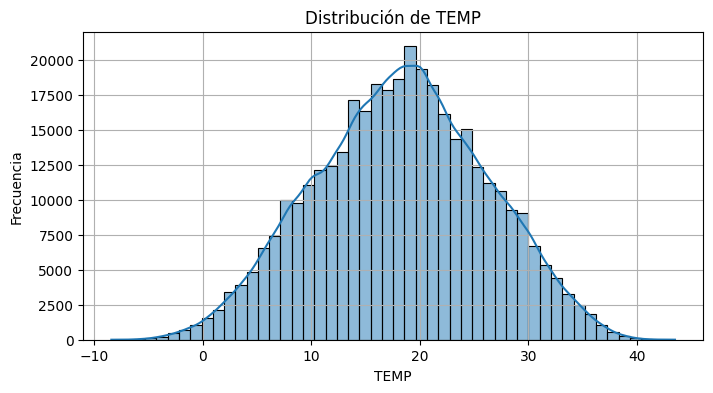

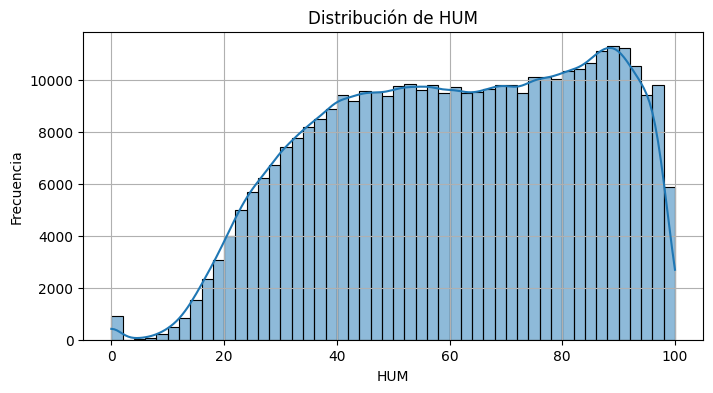

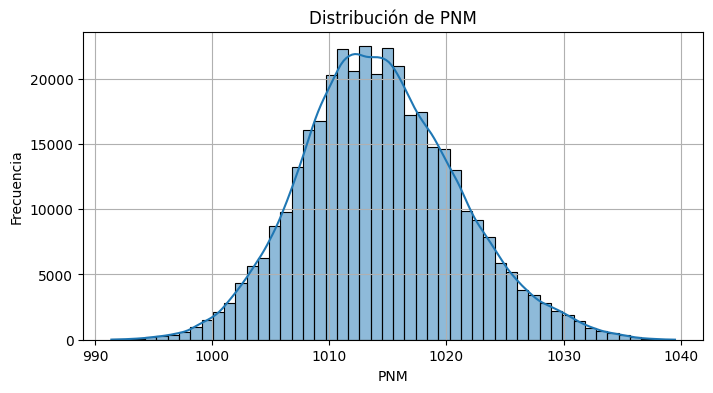

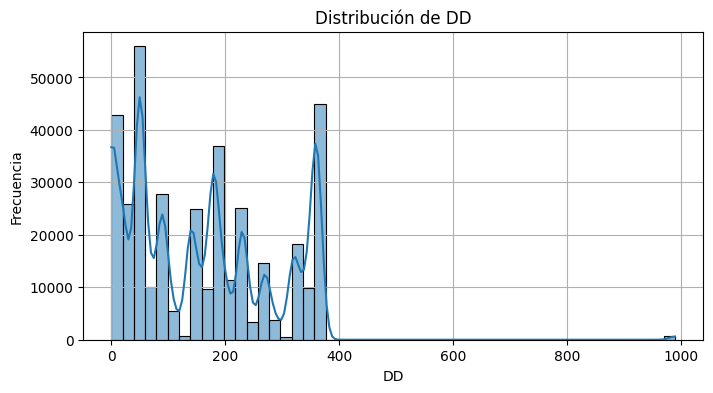

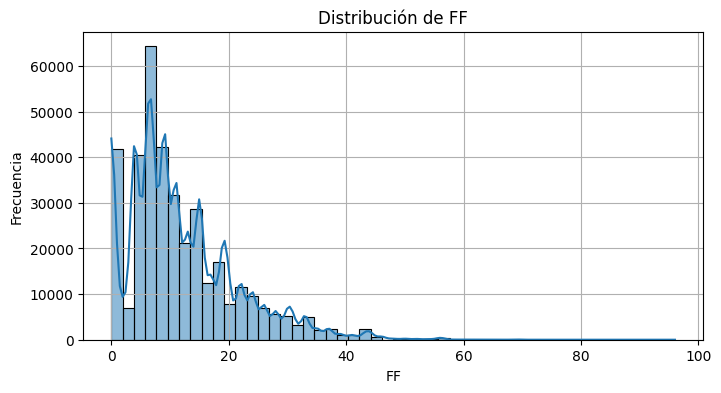

In [ ]:
#from scipy.stats import shapiro

columnas_a_testear = ['TEMP', 'HUM', 'PNM', 'DD', 'FF']

#for col in columnas_a_testear:
    #data = df_final[col].dropna()[:5000]  # máximo 5000 datos, Shapiro no tolera más
    #stat, p = shapiro(data)
    #print(f"{col} → p = {p:.4f}")
    #if p > 0.05:
        #print("✔️ Posible distribución normal\n")
    #else:
        #print("❌ No sigue una distribución normal\n")

import seaborn as sns
import matplotlib.pyplot as plt

for col in columnas_a_testear:
    plt.figure(figsize=(8, 4))
    sns.histplot(df_final[col].dropna(), bins=50, kde=True)
    plt.title(f'Distribución de {col}')
    plt.xlabel(col)
    plt.ylabel('Frecuencia')
    plt.grid(True)
    plt.show()


(Se realizó un test de normalidad (Shapiro-Wilk), el cual arrojó p < 0.05 para todas las variables, indicando desviación de una distribución normal. El test de Shapiro-Wilk es muy sensible: Si se tienen muchos datos (incluso 300–5000), detecta cualquier desviación de la campana perfecta como “no normal”. Eso no significa que los datos estén mal, sino que no son perfectamente normales según el criterio matemático estricto del test. NO USAR ESTE TEST COMO CRITERIO, NO TOLERA MÁS DE 5000 DATOS.)

Sin embargo, la inspección visual mostró una distribución aproximadamente normal en X, Y y Z para algunas de las variables, lo que permite el uso del promedio para imputación en esos casos. Pero también se puede usar la interpolación en estos casos y los que no sean normales.

# EX **Segundo paso: ELIMINAR OUTLIERS**

Después de ver cómo es la distribución con los gráficos de distribución (histogramas, boxplots, etc.) como apoyo visual, debo eliminar los outliers.

Objetivo: eliminar outliers sin afectar la estacionalidad real
Entonces, lo ideal es usar umbrales que respeten el contexto climático, o sea:
✔️ la estación del año (verano, otoño, etc.)
✔️ la hora del día (porque no es lo mismo 3 AM que 15 PM)

Procedemos a eliminar outliers usando el método IQR, pero aplicándolo:

-Por estación

-Por variable

-Por mes

-Por hora

Esto es más robusto que aplicar IQR sobre todo el conjunto sin agrupar, ya que tiene en cuenta variaciones estacionales y diarias.

Este código mantiene la limpieza en memoria (df_limpio) sin guardar nada todavía en un archivo nuevo. La función se puede reutilizar para otras columnas fácilmente.

Aclaración importante: Estamos generando una nueva versión de los datos (df_clean) sin modificar el DataFrame original (df_final) que se armó antes. Esto es útil por varias razones:

-Preservar los datos originales:
Siempre es buena práctica mantener una copia de los datos sin procesar, por si se quiere comparar, revisar o rehacer algo distinto más adelante.

-Evitar errores acumulados:
Si se van aplicando filtros o transformaciones directamente sobre el DataFrame original, cualquier error podría modificar los datos irreversiblemente y no se podría volver atrás sin recargar el archivo.

-Facilitar debugging y control de calidad:
Poder comparar df_clean con df_final para ver cuántos datos se eliminaron por ser outliers, qué valores quedaron, etc.







In [ ]:
#import pandas as pd

# Agrupamos por estación, variable, mes y hora, y aplicamos IQR para detectar y eliminar outliers
#def remove_outliers_iqr(df, variable, estacion_col='ESTACION', fecha_col='FECHA_HORA'):
    #df = df.copy()

    # Aseguramos que la fecha sea datetime y extraemos mes si no existe
    #if 'MES' not in df.columns:
        #df['MES'] = pd.to_datetime(df[fecha_col]).dt.month

    # Extract hour from FECHA_HORA
    #if 'HORA' not in df.columns:
        #df['HORA'] = pd.to_datetime(df[fecha_col]).dt.hour

    # Creamos una máscara de booleanos con todos True (nada filtrado aún)
    #mask = pd.Series(True, index=df.index)

    # Agrupamos y aplicamos el método de IQR
    #grouped = df.groupby([estacion_col, 'MES', 'HORA'])

    #for name, group in grouped:
        #q1 = group[variable].quantile(0.25)
        #q3 = group[variable].quantile(0.75)
        #iqr = q3 - q1
        #lower = q1 - 1.5 * iqr
        #upper = q3 + 1.5 * iqr

        # Creamos una submáscara para este grupo
        #mask_group = (group[variable] >= lower) & (group[variable] <= upper)

        # Aplicamos la submáscara al índice original
        #mask.loc[group.index] = mask_group

    # Devolvemos el DataFrame filtrado
    #return df[mask]

# Lista de variables a limpiar
#variables = ['TEMP', 'HUM', 'PNM', 'DD', 'FF']

# Aplicamos la limpieza a cada variable sucesivamente
#df_limpio = df_final.copy() # Start with df_final which was created earlier

#for var in variables:
    #df_limpio = remove_outliers_iqr(df_limpio, var)

# **Segundo paso: IDENTIFICAR OUTLIERS**

Detección de outliers por MAD (temperatura, humedad, presión, velocidad)

El siguiente código:

* Calcula outliers con MAD (Median Absolute Deviation).

* Lo hace por estación, mes y hora (como tu método original con IQR).

* Devuelve el porcentaje de outliers por variable.

* No elimina nada, solo detecta.


*Caso especial: dirección del viento (DD)*

La dirección del viento es circular (0° ≈ 360°).
Si se aplica MAD directamente, el código pensaría que 359° y 1° están muy lejos (cuando en realidad están cerca).



In [ ]:
import numpy as np
import pandas as pd

# --- Función de detección de outliers con MAD agrupado ---
def detectar_outliers_mad(df, variable, estacion_col='ESTACION', fecha_col='FECHA_HORA', threshold=3.5):
    df = df.copy()

    if 'MES' not in df.columns:
        df['MES'] = pd.to_datetime(df[fecha_col]).dt.month

    if 'HORA' not in df.columns:
        df['HORA'] = pd.to_datetime(df[fecha_col]).dt.hour

    # Inicializamos máscara booleana (por defecto: no outlier)
    es_outlier = pd.Series(False, index=df.index)

    # Agrupamos según tus criterios contextuales
    grouped = df.groupby([estacion_col, 'MES', 'HORA'])

    for name, group in grouped:
        x = group[variable].dropna().copy()
        if len(x) < 5:  # evitar grupos con pocos datos
            continue
        median = np.median(x)
        mad = np.median(np.abs(x - median))
        if mad == 0:
            continue
        z_score_robusto = 0.6745 * (x - median) / mad
        mask = np.abs(z_score_robusto) > threshold
        es_outlier.loc[x.index] = mask

    return es_outlier


# --- Variables meteorológicas a evaluar (excepto dirección del viento) ---
variables_mad = ['TEMP', 'HUM', 'PNM', 'FF']

porcentaje_outliers_mad = {}

for var in variables_mad:
    outlier_mask = detectar_outliers_mad(df_final, var)
    total = df_final[var].notna().sum()
    n_outliers = outlier_mask.sum()
    porcentaje = (n_outliers / total) * 100
    porcentaje_outliers_mad[var] = round(porcentaje, 2)

porcentaje_outliers_mad


for var, pct in porcentaje_outliers_mad.items():
    total = df_final[var].notna().sum()
    n_outliers = int((pct / 100) * total)
    print(f"{var}: {pct}% de outliers ({n_outliers} de {total} valores)")


TEMP: 0.15% de outliers (558 de 372600 valores)
HUM: 0.94% de outliers (3501 de 372495 valores)
PNM: 0.13% de outliers (484 de 372578 valores)
FF: 2.16% de outliers (8048 de 372601 valores)


A continuación se trabaja la variable especial de la DD (dirección del viento):

Primero se calcula la media circular del viento (mean_dir),
porque en variables angulares (0–360°) la media tradicional no sirve (ej: entre 350° y 10° el promedio no es 180° sino 0°).
Entonces usamos la media circular, que representa la “dirección promedio” real del viento.

Después se calculan las desviaciones angulares absolutas
— o sea, cuánto se desvía cada medición de esa dirección media, pero respetando el sentido circular (de modo que entre 350° y 10° la diferencia sea 20°, no 340°).

Finalmente se aplica el MAD
— la mediana de esas desviaciones absolutas (no la media) y se multiplica por un factor (como 3) para marcar outliers.
Esto le da robustez, porque la mediana no se ve afectada por valores extremos.

In [ ]:
#CASO PARA LA DIRECCIÓN DEL VIENTO: DD

import numpy as np
import pandas as pd

df = df_final.copy()

if 'MES' not in df.columns:
    df['MES'] = pd.to_datetime(df['FECHA_HORA']).dt.month
if 'HORA' not in df.columns:
    df['HORA'] = pd.to_datetime(df['FECHA_HORA']).dt.hour

outlier_mask = pd.Series(False, index=df.index)

for name, group in df.groupby(['ESTACION', 'MES', 'HORA']):
    direccion = group['DD'].dropna().copy()
    if len(direccion) < 5:
        continue

    radianes = np.deg2rad(direccion)
    x = np.cos(radianes)
    y = np.sin(radianes)
    mean_x, mean_y = np.mean(x), np.mean(y)
    mean_angle = np.arctan2(mean_y, mean_x)
    mean_dir = np.rad2deg(mean_angle) % 360

    angular_diff = np.abs(((direccion - mean_dir + 180) % 360) - 180)
    mad = np.median(np.abs(angular_diff - np.median(angular_diff)))
    if mad == 0:
        continue

    threshold = 3 * mad
    mask_group = angular_diff > threshold
    outlier_mask.loc[direccion.index] = mask_group

# Resultados
porcentaje_outliers_dd = 100 * outlier_mask.mean()
print(f"Porcentaje de outliers (DD): {porcentaje_outliers_dd:.2f}%")


Porcentaje de outliers (DD): 31.64%


En el caso de la dirección del viento, el 31,6 % de los valores fue identificado como atípico según el método MAD circular. Dado que la dirección es una variable circular de alta variabilidad natural, no se consideró apropiado eliminar estos valores.

Por las dudas se van a realizar otras tres variantes para la detección de los outliers en DD:

* VARIANTE A: Aumentar el umbral de detección de 3 × MAD a 4 × MAD o incluso 5 × MAD.

* VARIANTE B: Agrupar más ampliamente (por estación y mes, sin hora).

* VARIANTE C: filtrar previamente los casos de viento muy débil (por ejemplo, FF < 1 m/s) y con umbral 4×MAD.


In [ ]:
import numpy as np
import pandas as pd

df = df_final.copy()

# Aseguramos columnas de mes y hora
if 'MES' not in df.columns:
    df['MES'] = pd.to_datetime(df['FECHA_HORA']).dt.month
if 'HORA' not in df.columns:
    df['HORA'] = pd.to_datetime(df['FECHA_HORA']).dt.hour

# --- Función para detectar outliers en DD con parámetros variables ---
def detectar_outliers_dd(df, group_cols, threshold=3, filtrar_viento=False):
    df = df.copy()
    if filtrar_viento and 'FF' in df.columns:
        df = df[df['FF'] >= 1]  # eliminar casos con viento muy débil

    outlier_mask = pd.Series(False, index=df.index)

    for name, group in df.groupby(group_cols):
        direccion = group['DD'].dropna().copy()
        if len(direccion) < 5:
            continue

        radianes = np.deg2rad(direccion)
        x = np.cos(radianes)
        y = np.sin(radianes)
        mean_x, mean_y = np.mean(x), np.mean(y)
        mean_angle = np.arctan2(mean_y, mean_x)
        mean_dir = np.rad2deg(mean_angle) % 360

        angular_diff = np.abs(((direccion - mean_dir + 180) % 360) - 180)
        mad = np.median(np.abs(angular_diff - np.median(angular_diff)))
        if mad == 0:
            continue

        threshold_val = threshold * mad
        mask_group = angular_diff > threshold_val
        outlier_mask.loc[direccion.index] = mask_group

    porcentaje = 100 * outlier_mask.mean()
    return porcentaje

# --- Variante A: agrupar por ESTACION, MES y HORA (igual que antes), threshold = 3 ---
p1 = detectar_outliers_dd(df, ['ESTACION', 'MES', 'HORA'], threshold=3)

# --- Variante B: agrupar por ESTACION y MES, threshold = 3 ---
p2 = detectar_outliers_dd(df, ['ESTACION', 'MES'], threshold=3)

# --- Variante C: agrupar por ESTACION, MES y HORA, threshold = 4, filtrando viento débil ---
p3 = detectar_outliers_dd(df, ['ESTACION', 'MES', 'HORA'], threshold=4, filtrar_viento=True)

print(f"Variante A (por estación, mes y hora, umbral 3×MAD): {p1:.2f}% outliers")
print(f"Variante B (por estación y mes, umbral 3×MAD): {p2:.2f}% outliers")
print(f"Variante C (por estación, mes y hora, umbral 4×MAD y FF>=1): {p3:.2f}% outliers")


Variante A (por estación, mes y hora, umbral 3×MAD): 31.64% outliers
Variante B (por estación y mes, umbral 3×MAD): 34.33% outliers
Variante C (por estación, mes y hora, umbral 4×MAD y FF>=1): 17.11% outliers


La dirección del viento es intrínsecamente variable y circular, especialmente en regiones con cambios de viento frecuentes o vientos calmados.

Por eso, incluso con MAD circular, el porcentaje de “outliers” puede ser alto.

No conviene eliminar estos valores, porque gran parte representan fenómenos meteorológicos reales.

La detección de outliers en la dirección del viento (DD) usando el método MAD circular indicó un porcentaje alto de valores atípicos (17–34 %, según el criterio). Esto se debe a la alta variabilidad natural de la dirección del viento y a la presencia de vientos muy débiles. Por lo tanto, se decidió no eliminar valores, manteniendo toda la información disponible para el análisis climático.

**Conclusión metodológica**

TEMP, HUM, PNM y FF: los outliers son mínimos (<5 %), lo que respalda la decisión de no eliminarlos y mantener el dataset completo.

DD (dirección del viento): los outliers son numerosos por la variabilidad natural y los vientos débiles. Aunque el método estadístico los marque, no representan errores, sino fenómenos meteorológicos reales. Por lo que se mantienen todos los valores.

Método multivariante:
El MCD es multivariante
→ detecta outliers que son "raros" considerando el conjunto completo

In [ ]:
# --- OUTLIERS MULTIVARIADOS: MCD ---

from sklearn.covariance import MinCovDet
from scipy.stats import chi2

# Dataset multivariado sin nulos
rmf = df_final[['TEMP', 'HUM', 'PNM', 'FF']].dropna()

# --- CREAR COLUMNA OUTLIER_MAD (combina TEMP, HUM, PNM, FF) ---
df_final['OUTLIER_MAD'] = False

for var in variables_mad:
    mask_var = detectar_outliers_mad(df_final, var)
    # OR bit a bit → si alguna variable es outlier, marca True
    df_final.loc[mask_var.index, 'OUTLIER_MAD'] |= mask_var


# Entrenar MCD
mcd = MinCovDet(random_state=0).fit(rmf)

# Distancias robustas de Mahalanobis
dist_mcd = mcd.mahalanobis(rmf)

# Umbral: Chi-cuadrado con k variables (acá k = 4)
k = rmf.shape[1]
umbral = chi2.ppf(0.975, k)

# Máscara de outliers multivariados
outliers_mcd = dist_mcd > umbral

# Agregar al dataframe
df_final['OUTLIER_MCD'] = False
df_final.loc[rmf.index, 'OUTLIER_MCD'] = outliers_mcd

# Resumen
n_out = outliers_mcd.sum()
pct_out = 100 * n_out / len(rmf)
print(f"Outliers multivariados detectados por MCD: {n_out} ({pct_out:.2f}%)")

# --- OUTLIER FINAL = MAD + DD + MCD ---
df_final['OUTLIER_FINAL'] = (
    df_final['OUTLIER_MCD'] |
    df_final['OUTLIER_MAD'] |
    outlier_mask  # este es el de DD
)

print("Total de outliers finales:", df_final['OUTLIER_FINAL'].sum())


Outliers multivariados detectados por MCD: 32970 (8.85%)
Total de outliers finales: 141485


In [ ]:
len(df_final)


372686

# **Tercer paso: RELLENAR DATOS FALTANTES**

Después de haber analizado los outliers por estación y decidir dejarlos, el siguiente paso natural es rellenar los valores faltantes que hayan quedado después del filtrado. Esto es clave para poder entrenar luego el modelo ARIMA o SARIMAX sin que salten errores por NaN.

El siguiente código:

-Muestra cuántos valores faltantes (NaN) quedaron después del filtrado.

-Evalúa si son muchos o pocos (con criterio práctico). ¿Cuándo es "mucho"?   

<5% → Poco, se puede interpolar tranquilamente.

5–20% → Aceptable con interpolación, pero prestá atención a si hay patrones (por ejemplo, siempre falta la misma hora).

>20% → Riesgoso. Quizás deberías evaluar quitar esa variable o estación específica si está demasiado incompleta.

-Rellena los faltantes con interpolación agrupando por estación, mes y hora.

-Trata especialmente la dirección del viento (DD) como dato circular (ya que va de 0° a 360°). Se hace lo siguiente:

1- Convertir DD a coordenadas polares (sin y cos).

2- Interpolar sin y cos.

3- Calcular de nuevo el ángulo con atan2.

ACLARACIÓN: ¿POR QUÉ SE DECIDIÓ USAR INTERPOLACIÓN Y NO EL PROMEDIO?

Aunque una variable no tenga forma de campana en los gráficos previamente hechos(es decir, aunque no siga una distribución normal), la interpolación sigue siendo válida y, de hecho, muchas veces es preferible al promedio, sobre todo cuando se trabaja con series temporales o datos ordenados como en este caso.

¿Por qué está bien interpolar aunque no haya forma de campana?
El promedio asume que los valores están distribuidos de forma simétrica (como en una campana), lo cual puede ser poco representativo si hay asimetrías o valores extremos.

La interpolación, en cambio, se basa en los valores cercanos en el tiempo o en un grupo lógico (como mes y hora), por lo que preserva mejor la tendencia local de los datos.

Por ejemplo:

Si un día a las 10:00 hay un valor faltante de temperatura, y tenés datos para las 9:00 y 11:00, interpolar va a darte un valor intermedio coherente con ese contexto.

Esto es especialmente útil cuando tus datos tienen una estructura horaria y estacional, como los datos meteorológicos.


In [ ]:
# ===========================================
# 🔎 DETECTAR QUÉ MESES FALTAN POR ESTACIÓN
# ===========================================
import pandas as pd

# Asegurar formato datetime
df_final['FECHA_HORA'] = pd.to_datetime(df_final['FECHA_HORA'], errors='coerce')

# Crear columna año-mes
df_final['MES_ANIO'] = df_final['FECHA_HORA'].dt.to_period('M').dt.to_timestamp()

# DataFrame donde guardar resultados
faltantes_info = []

for estacion, df_est in df_final.groupby('ESTACION'):
    df_est = df_est.sort_values('MES_ANIO')
    primer = df_est['MES_ANIO'].min()
    ultimo = df_est['MES_ANIO'].max()

    # Crear rango completo mensual esperado
    rango_completo = pd.date_range(start=primer, end=ultimo, freq='MS')

    # Detectar meses faltantes
    meses_presentes = df_est['MES_ANIO'].unique()
    meses_faltantes = rango_completo.difference(meses_presentes)

    if len(meses_faltantes) > 0:
        for m in meses_faltantes:
            faltantes_info.append({'ESTACION': estacion, 'MES_FALTANTE': m})

# Convertir a DataFrame
df_faltantes = pd.DataFrame(faltantes_info)

if df_faltantes.empty:
    print("✅ No faltan meses completos en ninguna estación.")
else:
    print("⚠️ Meses faltantes detectados:")
    print(df_faltantes.sort_values(['ESTACION', 'MES_FALTANTE']))


⚠️ Meses faltantes detectados:
            ESTACION MES_FALTANTE
0  CORDOBA OBSERVATO   2022-02-01
1  ESCUELA DE AVIACI   2022-02-01
2  MARCOS JUAREZ AER   2022-02-01
3  PILAR OBSERVATORI   2022-02-01
4  VILLA DE MARIA DE   2022-02-01
5  VILLA DOLORES AER   2022-02-01


In [ ]:
# ===========================================
# 🔍 Chequeo de duplicados por estación
# ===========================================

duplicados_info = (
    df_final[df_final.duplicated(subset=['ESTACION', 'FECHA_HORA'], keep=False)]
    .groupby('ESTACION')['FECHA_HORA']
    .count()
    .reset_index(name='Cantidad_duplicados')
    .sort_values('Cantidad_duplicados', ascending=False)
)

if duplicados_info.empty:
    print("✅ No hay filas duplicadas por estación.")
else:
    print("⚠️ Se detectaron duplicados en estas estaciones:")
    print(duplicados_info)


⚠️ Se detectaron duplicados en estas estaciones:
            ESTACION  Cantidad_duplicados
0  CORDOBA OBSERVATO                   48
2     LABOULAYE AERO                   48
7  VILLA DOLORES AER                   48
1  ESCUELA DE AVIACI                   36
4  PILAR OBSERVATORI                   36
3  MARCOS JUAREZ AER                   32
5    RIO CUARTO AERO                   32
6  VILLA DE MARIA DE                   16


In [ ]:
import numpy as np
import pandas as pd

# =====================================================
# 1️⃣ FUNCIÓN: rellenar mes faltante (ej. febrero 2022)
# =====================================================

def rellenar_mes_faltante(df, mes_faltante='2022-02'):
    mes_dt = pd.to_datetime(mes_faltante)
    mes_prev = mes_dt - pd.DateOffset(months=1)
    mes_next = mes_dt + pd.DateOffset(months=1)

    frames = []

    for estacion, df_est in df.groupby('ESTACION'):
        df_est = df_est.sort_values('FECHA_HORA').set_index('FECHA_HORA')

        # 💡 Eliminar duplicados en el índice temporal
        df_est = df_est[~df_est.index.duplicated(keep='first')]

        # Si falta el mes especificado (por defecto, febrero 2022)
        if not ((df_est.index.month == mes_dt.month) & (df_est.index.year == mes_dt.year)).any():
            print(f"🔧 Rellenando {mes_faltante} en {estacion}...")

            # Crear rango horario del mes faltante
            rango_mes = pd.date_range(
                start=mes_dt,
                end=mes_next - pd.DateOffset(days=1, hours=-23),
                freq='h'
            )

            df_new = pd.DataFrame({'FECHA_HORA': rango_mes})
            df_new['ESTACION'] = estacion
            df_new = df_new.set_index('FECHA_HORA')

            # --- 1️⃣ Interpolación temporal para TEMP, HUM, PNM ---
            for var in ['TEMP', 'HUM', 'PNM']:
                serie = df_est[var].interpolate(method='time', limit_direction='both')
                df_new[var] = serie.reindex(df_new.index, method='nearest')

            # --- 2️⃣ Mediana horaria enero+marzo para FF ---
            ene = df_est[(df_est.index.month == mes_prev.month) & (df_est.index.year == mes_prev.year)]
            mar = df_est[(df_est.index.month == mes_next.month) & (df_est.index.year == mes_next.year)]

            if not ene.empty or not mar.empty:
                df_comb = pd.concat([ene, mar])
                df_comb['HORA'] = df_comb.index.hour
                ff_mediana = df_comb.groupby('HORA')['FF'].median()
                df_new['FF'] = df_new.index.hour.map(ff_mediana)
            else:
                df_new['FF'] = np.nan

            # --- 3️⃣ Interpolación circular para DD ---
            dd = df_est['DD'].copy()
            dd_rad = np.deg2rad(dd)
            dd_sin = np.sin(dd_rad).interpolate(method='time', limit_direction='both')
            dd_cos = np.cos(dd_rad).interpolate(method='time', limit_direction='both')

            df_new['DD'] = np.rad2deg(
                np.arctan2(
                    dd_sin.reindex(df_new.index, method='nearest'),
                    dd_cos.reindex(df_new.index, method='nearest')
                )
            ) % 360

            # --- Unir ---
            frames.append(pd.concat([df_est, df_new]).sort_index().reset_index())
        else:
            frames.append(df_est.reset_index())

    df_final = pd.concat(frames, ignore_index=True)
    return df_final


# =====================================================
# 2️⃣ Ejecutar la función antes de crear df_interp
# =====================================================
df_final = rellenar_mes_faltante(df_final, mes_faltante='2022-02')

# Verificar que no queden meses incompletos
faltantes_por_mes = (
    df_final.groupby(['ESTACION', df_final['FECHA_HORA'].dt.to_period('M')])
    .size()
    .reset_index(name='cuentas')
)
print("Meses con menos de 27 días de datos:",
      faltantes_por_mes[faltantes_por_mes['cuentas'] < 27])

# =====================================================
# 3️⃣ Interpolación por grupo (para suavizar huecos menores)
# =====================================================
df_interp = df_final.copy()

nan_counts = df_final.isna().sum()
print("\nValores faltantes por variable:\n", nan_counts)

nan_percent = df_final.isna().mean() * 100
print("\nPorcentaje de valores faltantes:\n", nan_percent)

# Asegurarse de que FECHA_HORA es datetime
df_interp['FECHA_HORA'] = pd.to_datetime(df_interp['FECHA_HORA'])

# Extraer mes y hora
df_interp['MES'] = df_interp['FECHA_HORA'].dt.month
df_interp['HORA'] = df_interp['FECHA_HORA'].dt.hour

# --- Interpolación para variables continuas ---
for var in ['TEMP', 'HUM', 'PNM']:
    df_interp[var] = (
        df_interp
        .groupby(['ESTACION', 'MES', 'HORA'])[var]
        .transform(lambda x: x.interpolate(method='linear', limit_direction='both') if x.notna().any() else x)
    )

# --- Interpolación robusta para FF (velocidad del viento, no normal) ---
def interp_ff(x):
    if x.notna().sum() < 2:
        return x
    idx = np.arange(len(x))
    idx_valid = idx[x.notna()]
    vals = np.sqrt(x[x.notna()])
    interp_vals = np.interp(idx, idx_valid, vals)
    return np.square(interp_vals)

df_interp['FF'] = (
    df_interp
    .groupby(['ESTACION', 'MES', 'HORA'])['FF']
    .transform(interp_ff)
)

# --- Dirección del viento (DD) usando interpolación circular ---
dd_rad = np.deg2rad(df_interp['DD'])
df_interp['DD_sin'] = np.sin(dd_rad)
df_interp['DD_cos'] = np.cos(dd_rad)

for comp in ['DD_sin', 'DD_cos']:
    df_interp[comp] = (
        df_interp
        .groupby(['ESTACION', 'MES', 'HORA'])[comp]
        .transform(lambda x: x.interpolate(method='linear', limit_direction='both') if x.notna().any() else x)
    )

df_interp['DD'] = np.rad2deg(np.arctan2(df_interp['DD_sin'], df_interp['DD_cos'])) % 360
df_interp.drop(columns=['DD_sin', 'DD_cos'], inplace=True)

print("\nValores faltantes por variable después de interpolar:\n", df_interp.isna().sum())


🔧 Rellenando 2022-02 en CORDOBA OBSERVATO...
🔧 Rellenando 2022-02 en ESCUELA DE AVIACI...
🔧 Rellenando 2022-02 en MARCOS JUAREZ AER...
🔧 Rellenando 2022-02 en PILAR OBSERVATORI...
🔧 Rellenando 2022-02 en VILLA DE MARIA DE...
🔧 Rellenando 2022-02 en VILLA DOLORES AER...
Meses con menos de 27 días de datos: Empty DataFrame
Columns: [ESTACION, FECHA_HORA, cuentas]
Index: []

Valores faltantes por variable:
 FECHA_HORA          0
TEMP               86
HUM               191
PNM               108
DD                 83
FF                589
ESTACION            0
OUTLIER_MAD      4032
OUTLIER_MCD      4032
OUTLIER_FINAL    4032
MES_ANIO         4032
dtype: int64

Porcentaje de valores faltantes:
 FECHA_HORA       0.000000
TEMP             0.022838
HUM              0.050721
PNM              0.028680
DD               0.022041
FF               0.156412
ESTACION         0.000000
OUTLIER_MAD      1.070717
OUTLIER_MCD      1.070717
OUTLIER_FINAL    1.070717
MES_ANIO         1.070717
dtype: float64



# **Cuarto paso: VERIFICAR SI CAMBIÓ LA DISTRIBUCIÓN DE LOS DATOS**

Repetir los gráficos (histogramas, KDE) que se hizo al inicio, pero ahora con df_interp (los datos ya limpios e interpolados). Así comparar visualmente.




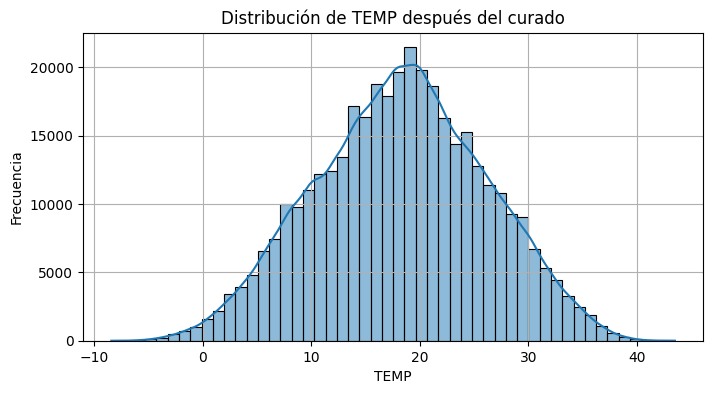

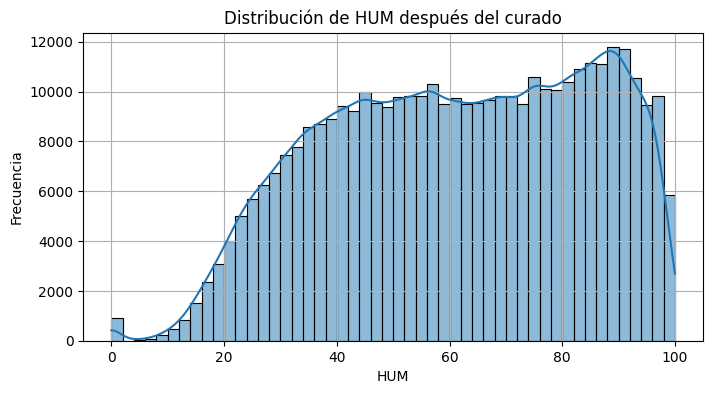

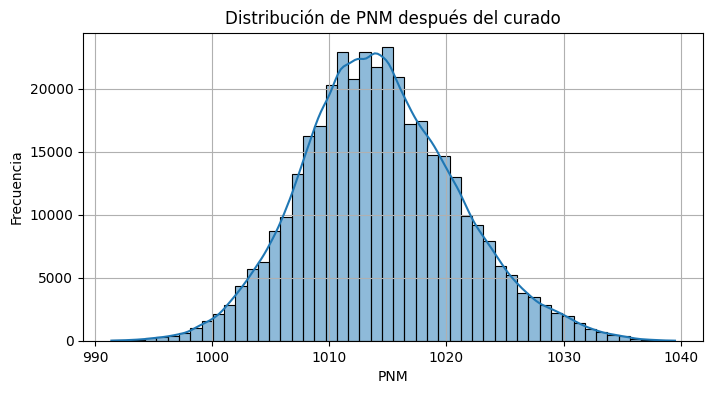

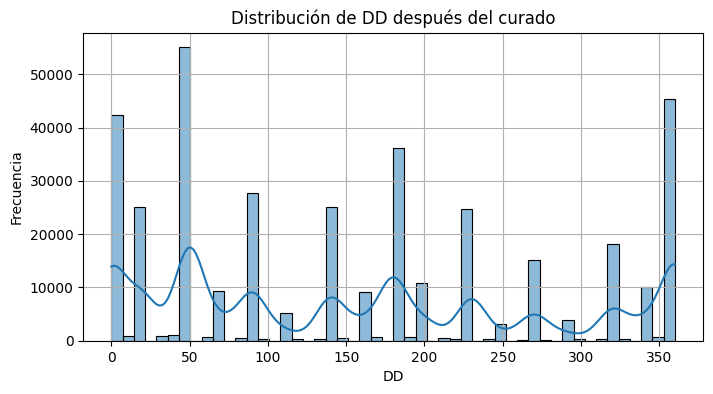

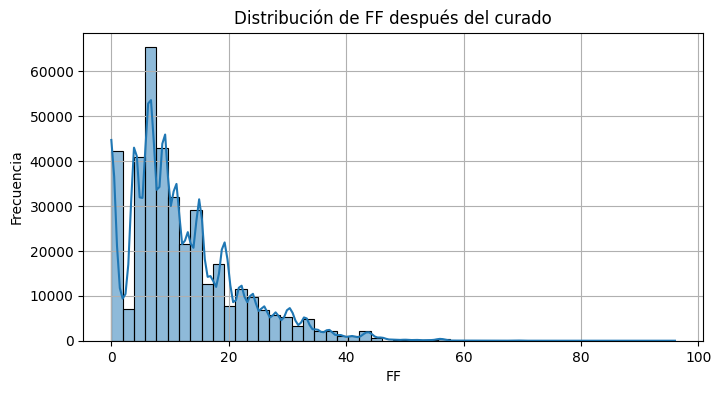

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

columnas_a_graficar = ['TEMP', 'HUM', 'PNM', 'DD', 'FF']

for col in columnas_a_graficar:
    plt.figure(figsize=(8, 4))
    sns.histplot(df_interp[col].dropna(), bins=50, kde=True)
    plt.title(f'Distribución de {col} después del curado')
    plt.xlabel(col)
    plt.ylabel('Frecuencia')
    plt.grid(True)
    plt.show()


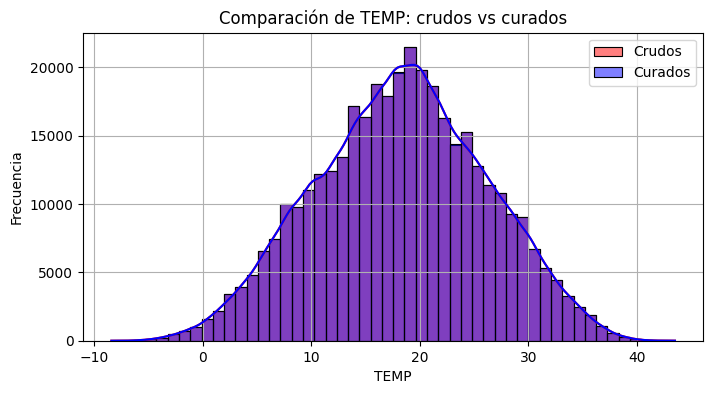

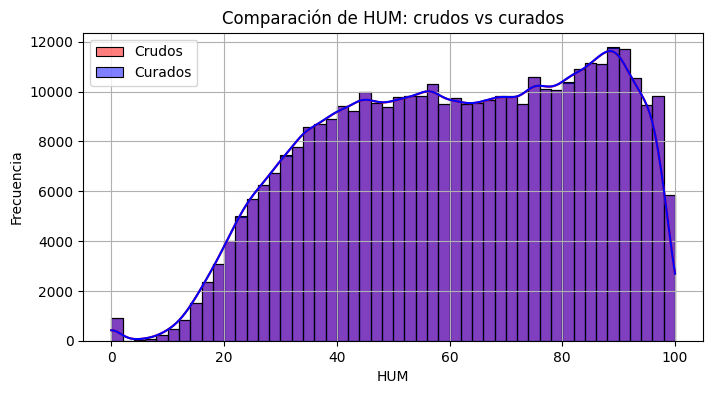

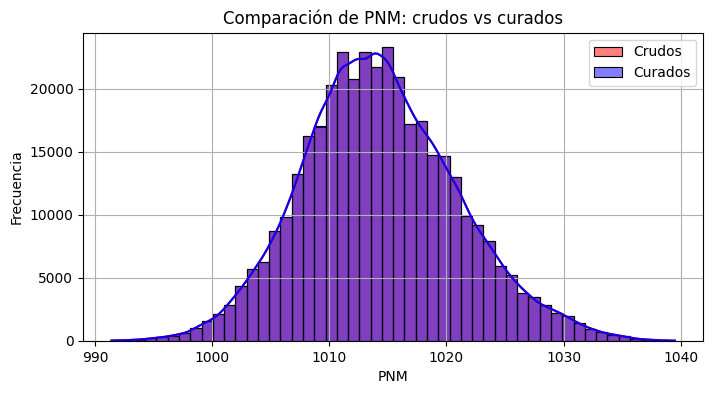

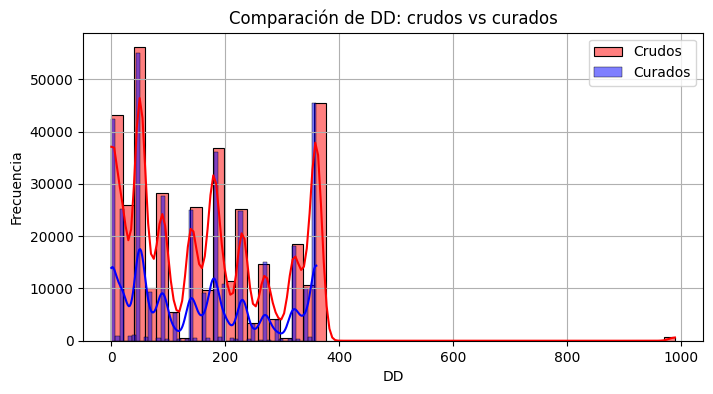

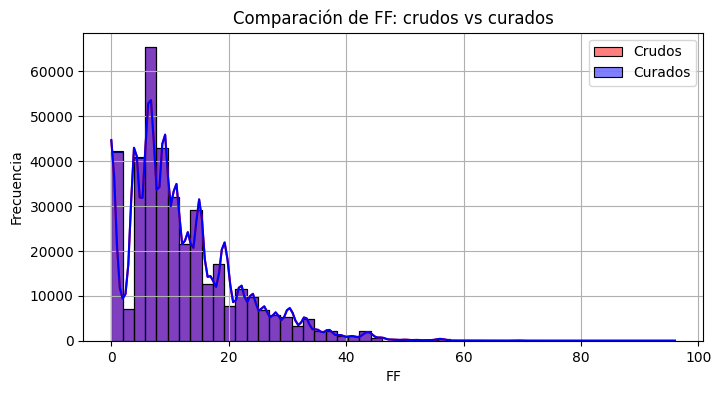

In [ ]:
#Comparación con los datos crudos (CHEQUEAR)
for col in columnas_a_graficar:
    plt.figure(figsize=(8, 4))
    sns.histplot(df_final[col].dropna(), bins=50, color='red', alpha=0.5, label='Crudos', kde=True)
    sns.histplot(df_interp[col].dropna(), bins=50, color='blue', alpha=0.5, label='Curados', kde=True)
    plt.title(f'Comparación de {col}: crudos vs curados')
    plt.xlabel(col)
    plt.ylabel('Frecuencia')
    plt.legend()
    plt.grid(True)
    plt.show()


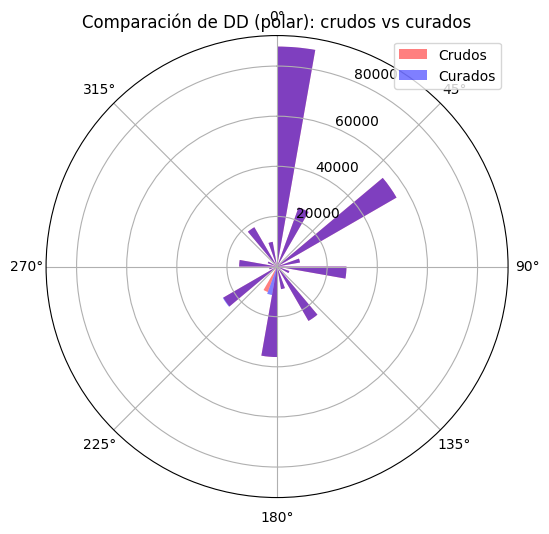

In [ ]:
#CHEQUEAR SI ES ÚTIL Y SI ESTÁ BIEN

import matplotlib.pyplot as plt
import numpy as np

# Convertir a radianes
dd_crudos = np.deg2rad(df_final['DD'].dropna() % 360)
dd_curados = np.deg2rad(df_interp['DD'].dropna() % 360)

# Definir bins (por ejemplo, 36 bins de 10° cada uno)
bins = np.linspace(0, 2*np.pi, 37)

# Histograma polar
plt.figure(figsize=(6,6))
ax = plt.subplot(111, polar=True)
ax.hist(dd_crudos, bins=bins, color='red', alpha=0.5, label='Crudos')
ax.hist(dd_curados, bins=bins, color='blue', alpha=0.5, label='Curados')
ax.set_theta_zero_location('N')  # 0° en el norte
ax.set_theta_direction(-1)       # horario
plt.title('Comparación de DD (polar): crudos vs curados')
plt.legend(loc='upper right')
plt.show()


# **Quinto paso: INFORMACIÓN Y GRÁFICOS DE LOS DATOS INTERPOLADOS DEL SMN**

Repetir lo mismo que se hizo al inicio con los datos crudos, pero ahora con df_interp

Se realizan gráficos POR ESTACIONES:

-Gráficos de líneas (con una versión suavizada también con la media móvil)

-Boxplots

-Histogramas


In [ ]:
# --- Chequeo para df_limpio (datos interpolados) ---
print("\n\n===== CHEQUEO DE DF_LIMPIO=====")
print("Dimensiones:", df_interp.shape)
print("\nTipos de datos y nulos por columna:")
print(df_interp.info())
print("\nValores nulos por columna:")
print(df_interp.isna().sum())
print("\nPorcentaje de nulos por columna:")
print((df_interp.isna().mean() * 100).round(2))
print("\nEstadísticas descriptivas:")
print(df_interp.describe(include='all'))
print("\nPrimeras filas:")
print(df_interp.head())



===== CHEQUEO DE DF_LIMPIO=====
Dimensiones: (376570, 13)

Tipos de datos y nulos por columna:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 376570 entries, 0 to 376569
Data columns (total 13 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   FECHA_HORA     376570 non-null  datetime64[ns]
 1   TEMP           376570 non-null  float64       
 2   HUM            376570 non-null  float64       
 3   PNM            376570 non-null  float64       
 4   DD             376570 non-null  float64       
 5   FF             376569 non-null  float64       
 6   ESTACION       376570 non-null  object        
 7   OUTLIER_MAD    372538 non-null  object        
 8   OUTLIER_MCD    372538 non-null  object        
 9   OUTLIER_FINAL  372538 non-null  object        
 10  MES_ANIO       372538 non-null  datetime64[ns]
 11  MES            376570 non-null  int32         
 12  HORA           376570 non-null  int32         
dtypes: date

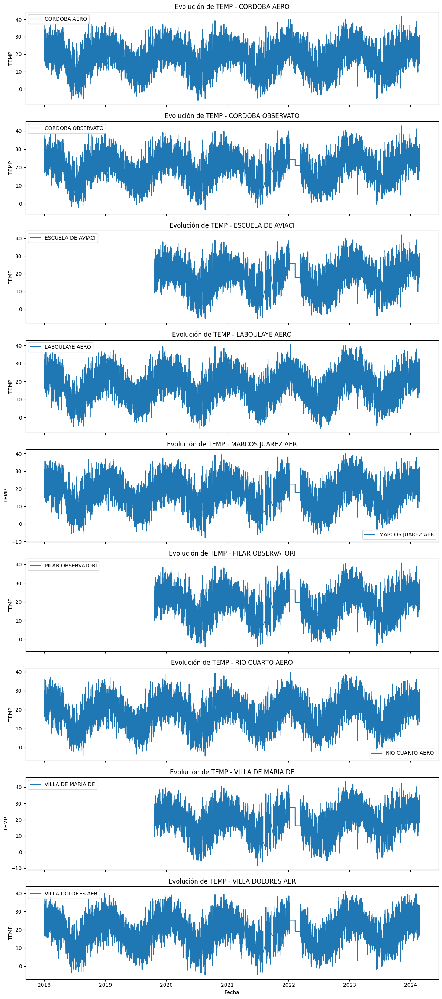

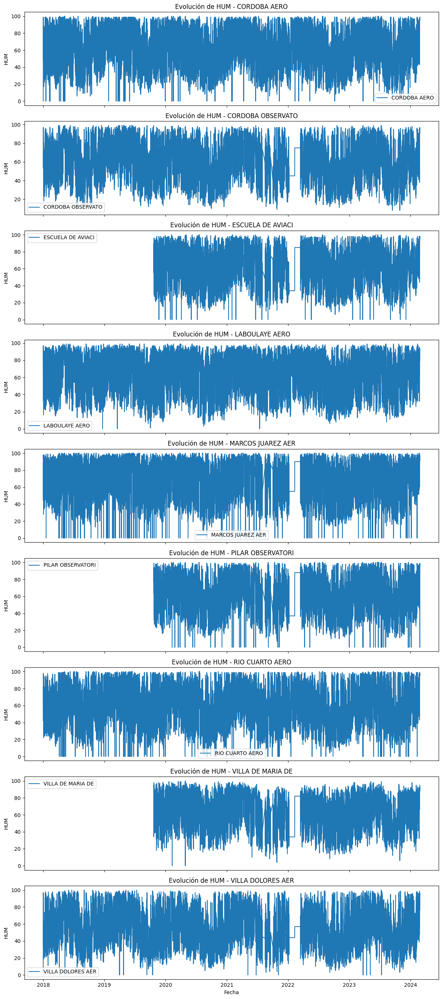

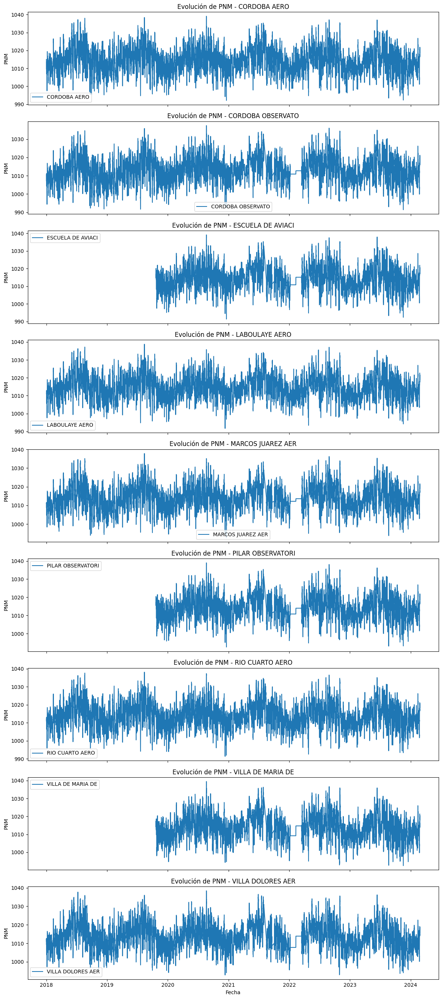

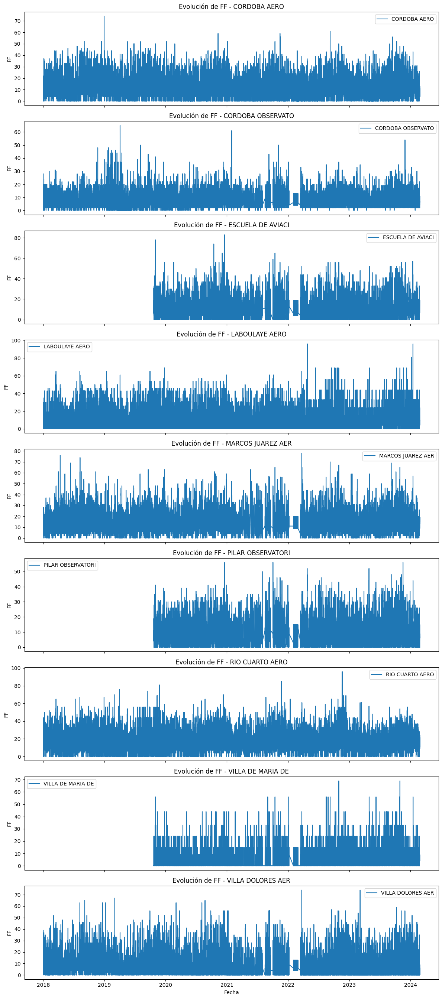

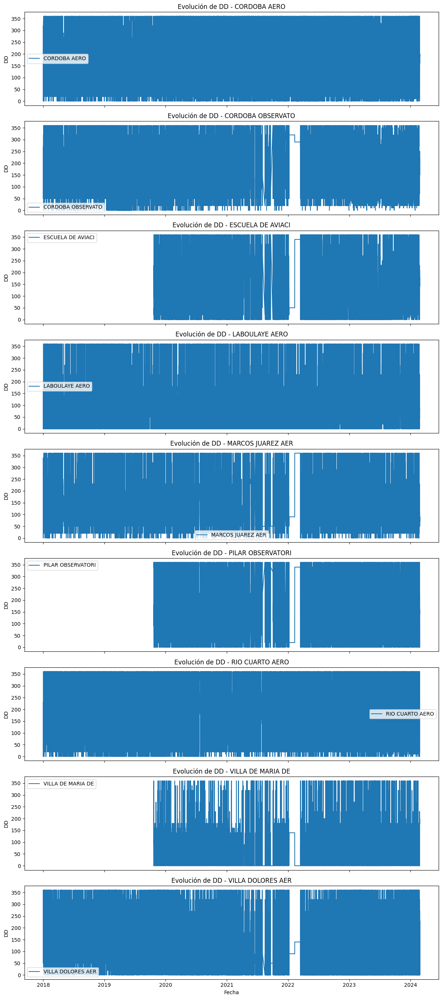

In [ ]:
# Lista de variables meteorológicas a analizar
variables = ['TEMP', 'HUM', 'PNM', 'FF', 'DD']

# =====================
# 1. Gráfico de líneas por estación y variable
# =====================
for var in variables:
    estaciones = df_interp['ESTACION'].unique()
    n = len(estaciones)
    fig, axes = plt.subplots(n, 1, figsize=(12, 3*n), sharex=True)

    for i, est in enumerate(estaciones):
        df_est = df_interp[df_interp['ESTACION'] == est]
        axes[i].plot(df_est['FECHA_HORA'], df_est[var], label=est)
        axes[i].set_title(f"Evolución de {var} - {est}")
        axes[i].set_ylabel(var)
        axes[i].legend()

    plt.xlabel("Fecha")
    plt.tight_layout()
    plt.show()

ACLARACIÓN:

La cajita (esa zona donde el gráfico parece tener una banda plana o “bloque”) aparece porque en febrero de 2022 faltaban datos, y al rellenarlos, la interpolación generó valores suaves o iguales entre sí. Por eso se ve como una línea o caja regular —no es un error, solo un efecto visual del método de relleno.

El zig-zag (cuando una variable parece un poco más irregular o con picos raros) también es consecuencia del relleno o de pequeños cortes en los datos. En términos de modelo, eso no lo rompe: SARIMAX puede manejarlo sin problema, especialmente si los faltantes fueron pocos (como en tu caso).

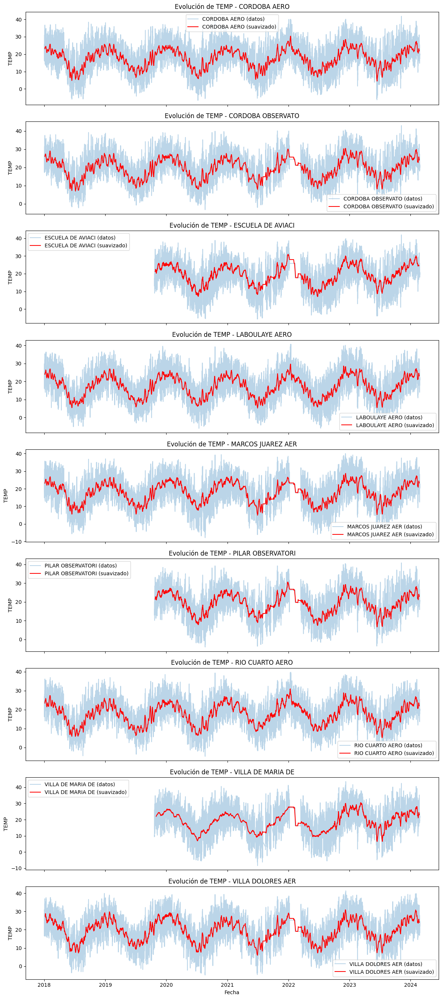

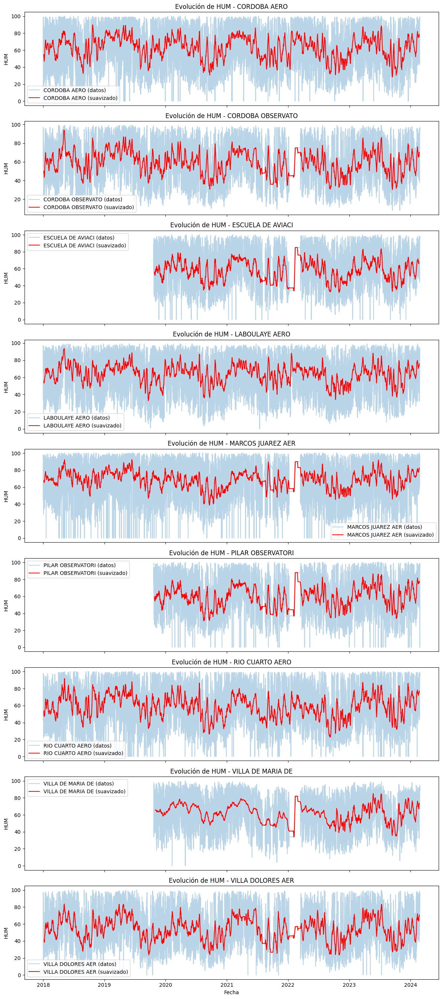

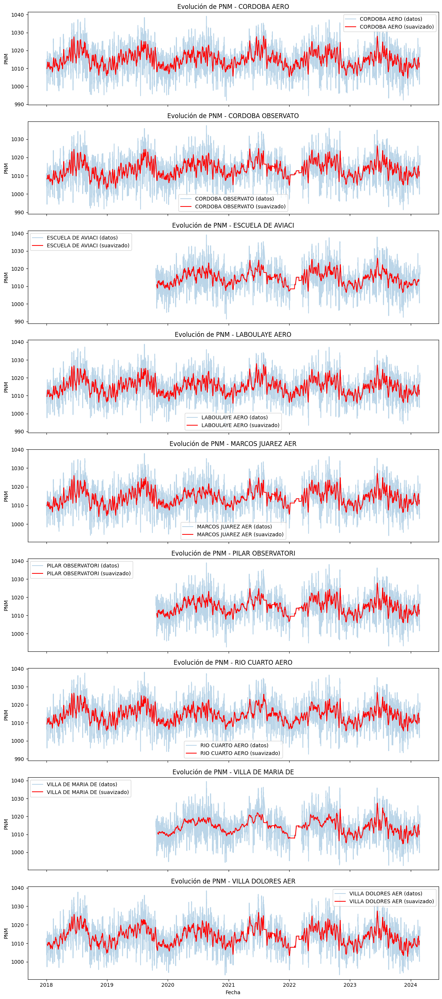

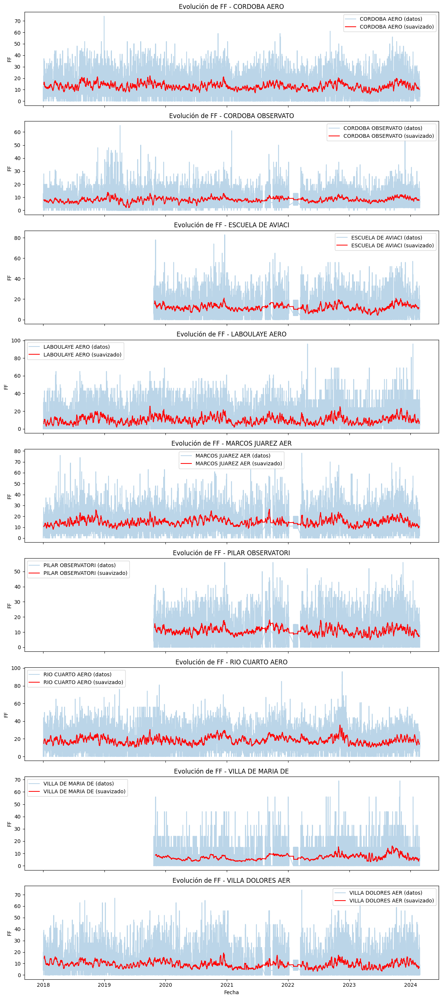

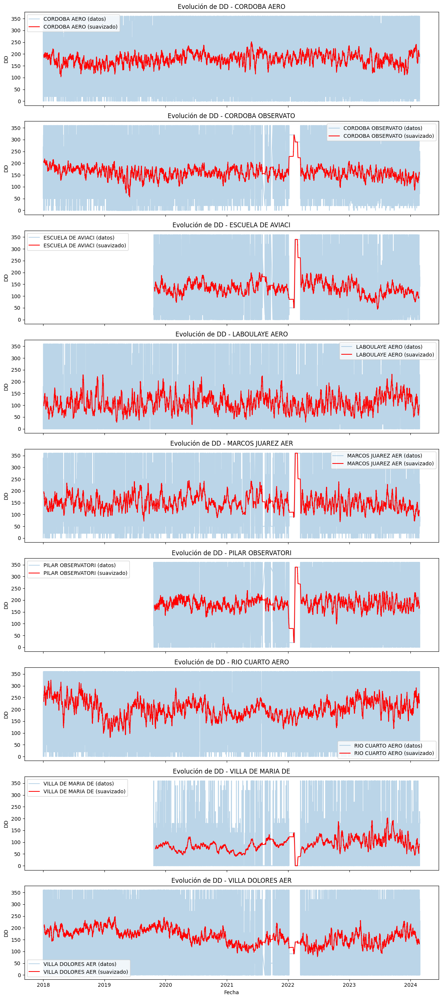

In [ ]:
#Para suavizar los gráficos porque se ven muy cargados, con menos ruido, se realiza gráficos con la media móvil
for var in variables:
    estaciones = df_interp['ESTACION'].unique()
    n = len(estaciones)
    fig, axes = plt.subplots(n, 1, figsize=(12, 3*n), sharex=True)

    for i, est in enumerate(estaciones):
        df_est = df_interp[df_interp['ESTACION'] == est].copy()
        # Promedio móvil de 7 días (ajustalo según convenga)
        df_est[var+"_smooth"] = df_est[var].rolling(window=24*7, center=True).mean()

        axes[i].plot(df_est['FECHA_HORA'], df_est[var], alpha=0.3, label=f"{est} (datos)")
        axes[i].plot(df_est['FECHA_HORA'], df_est[var+"_smooth"], color="red", label=f"{est} (suavizado)")
        axes[i].set_title(f"Evolución de {var} - {est}")
        axes[i].set_ylabel(var)
        axes[i].legend()

    plt.xlabel("Fecha")
    plt.tight_layout()
    plt.show()


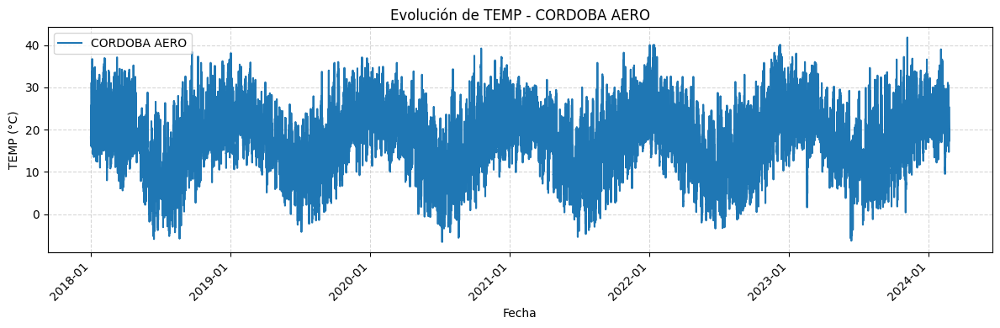

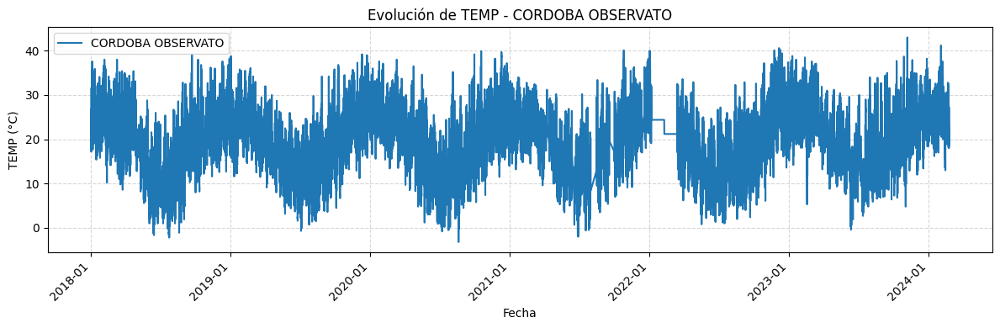

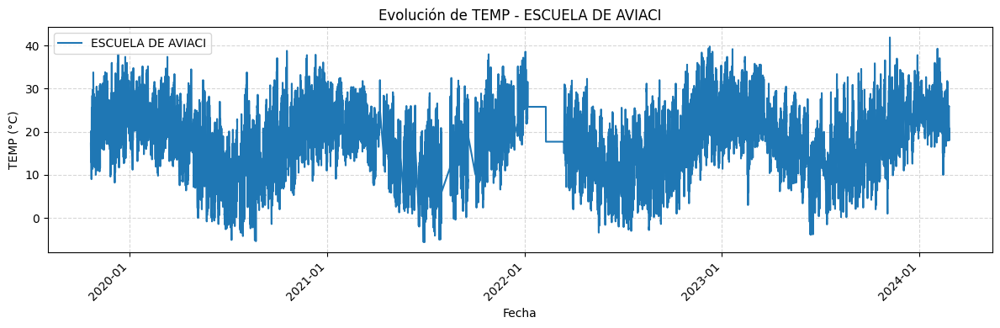

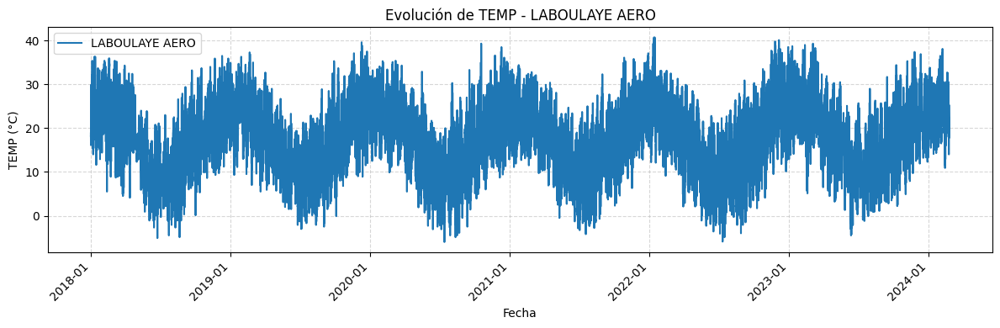

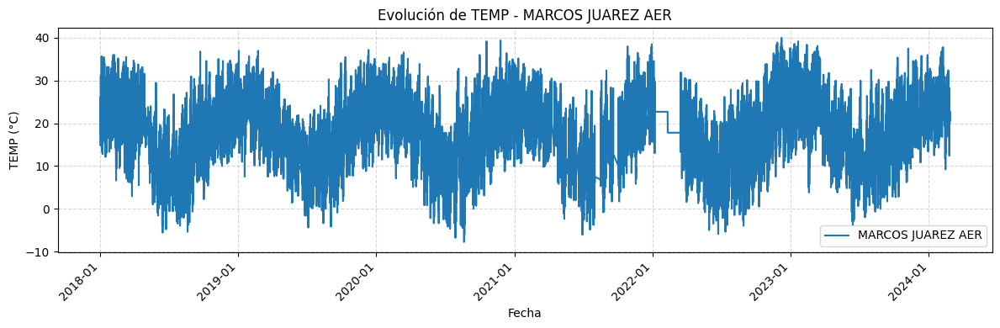

...

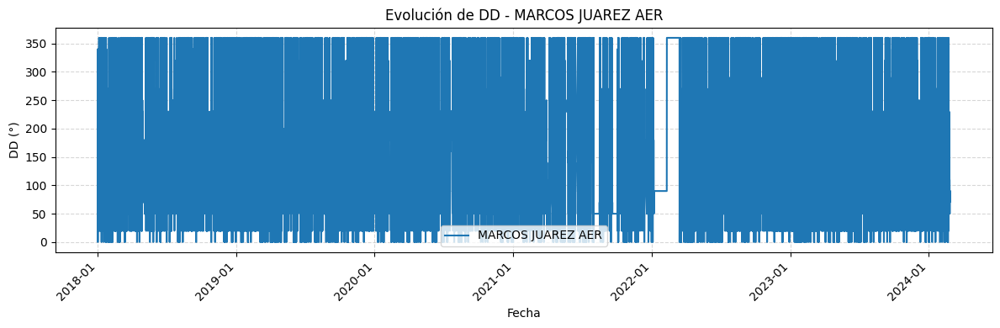

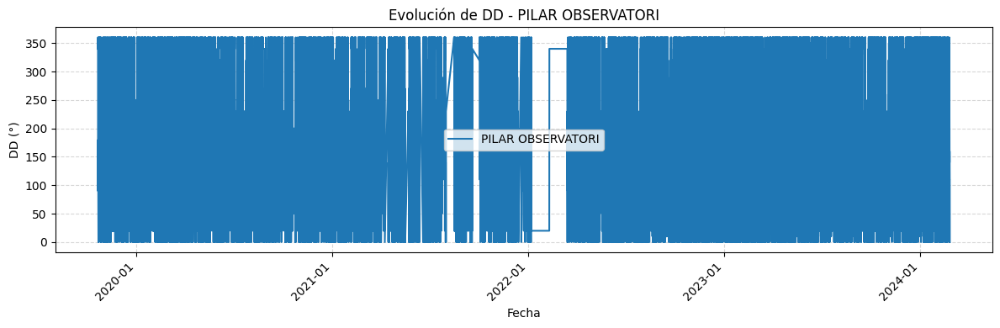

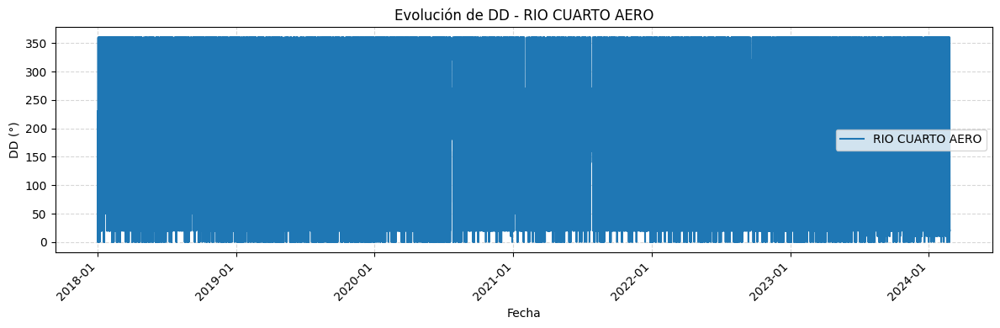

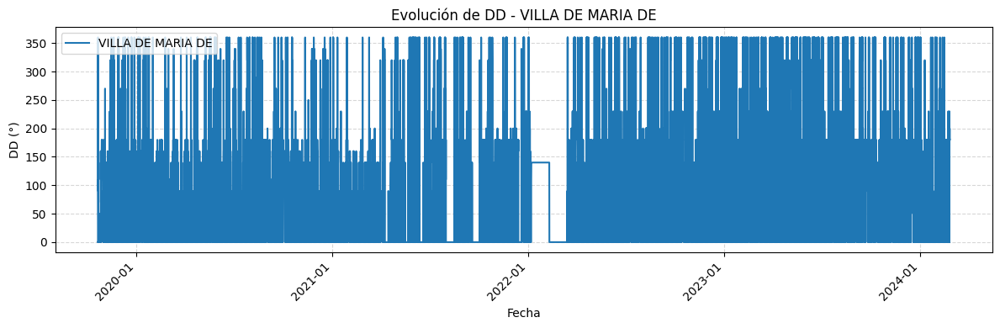

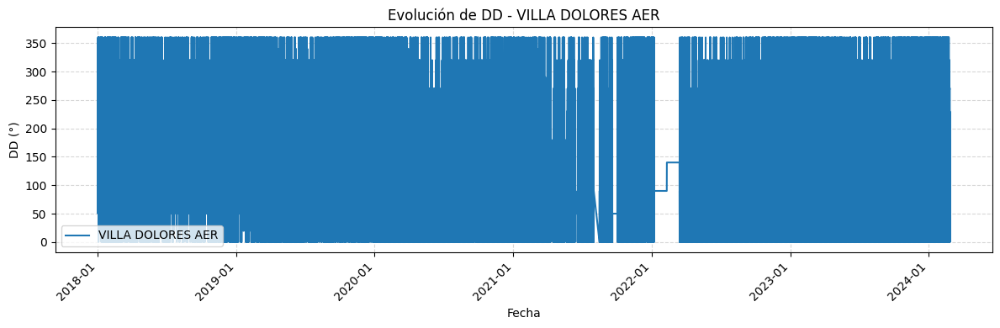

In [ ]:
import matplotlib.dates as mdates

# Diccionario de unidades según  columnas
unidades = {
    "TEMP": "°C",
    "HUM": "%",
    "PNM": "hPa",
    "DD": "°",
    "FF": "km/h"   # cambiar a m/s si dataset usa esa unidad
}

locator = mdates.YearLocator()       # Un tick por año
formatter = mdates.DateFormatter('%Y-%m')

for var in variables:
    for est in estaciones:

        df_est = df_interp[df_interp['ESTACION'] == est]

        fig, ax = plt.subplots(figsize=(12,4))
        ax.plot(df_est['FECHA_HORA'], df_est[var], label=est)

        ax.xaxis.set_major_locator(locator)
        ax.xaxis.set_major_formatter(formatter)

        plt.setp(ax.get_xticklabels(), rotation=45, ha='right')

        # Unidad correspondiente al var
        unidad = unidades.get(var, "")

        if unidad:
            ax.set_ylabel(f"{var} ({unidad})")
        else:
            ax.set_ylabel(var)

        ax.set_title(f"Evolución de {var} - {est}")
        ax.set_xlabel("Fecha")
        ax.legend()
        ax.grid(True, linestyle='--', alpha=0.5)

        plt.tight_layout()
        plt.show()


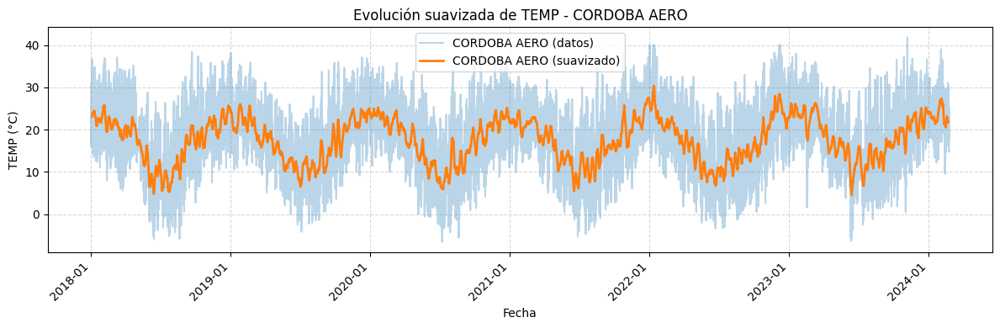

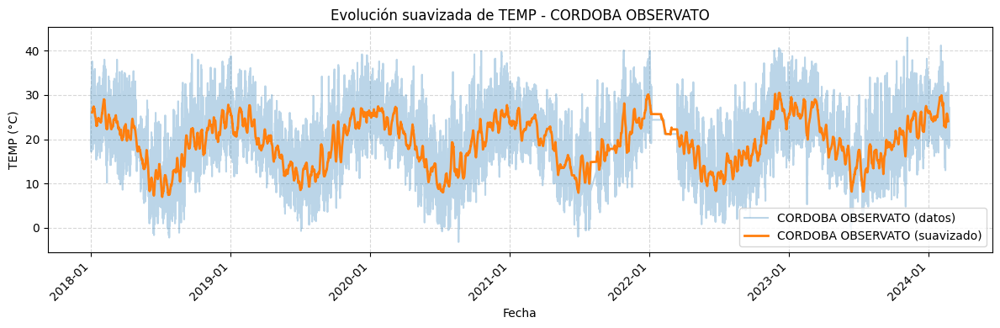

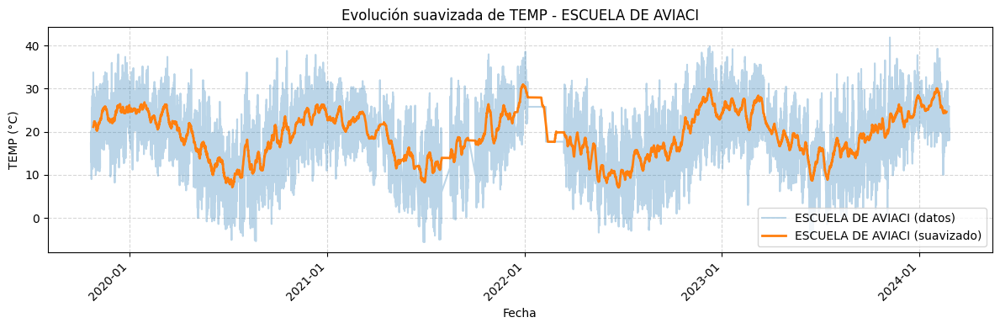

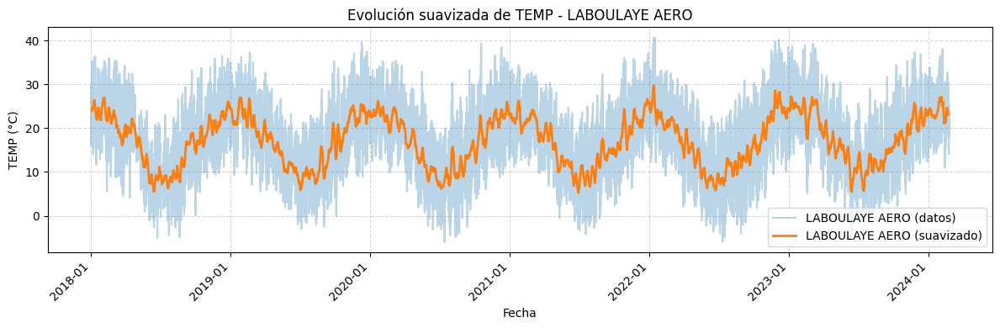

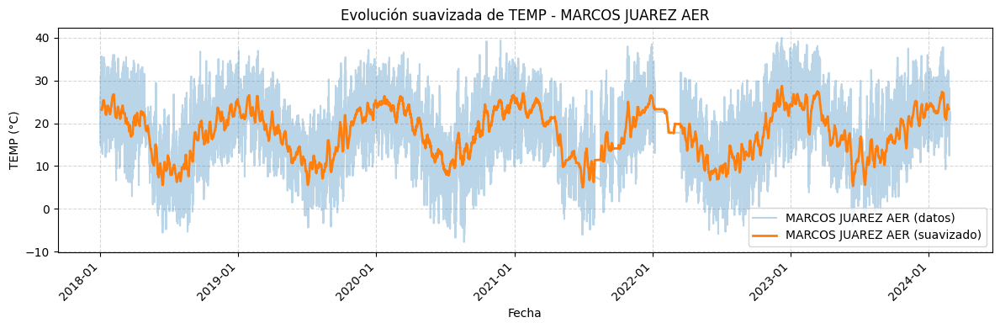

...

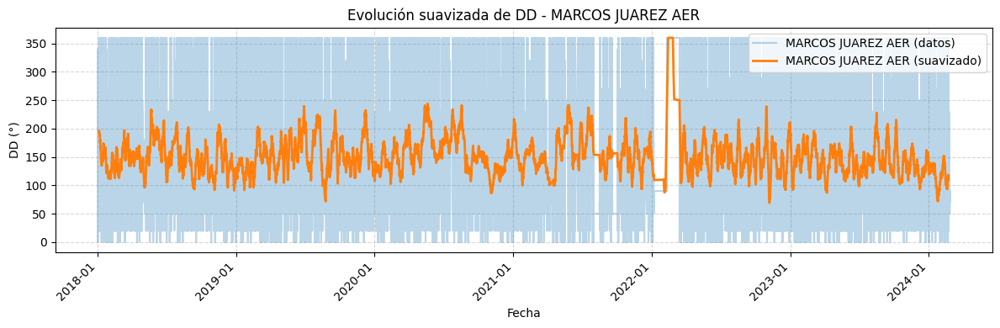

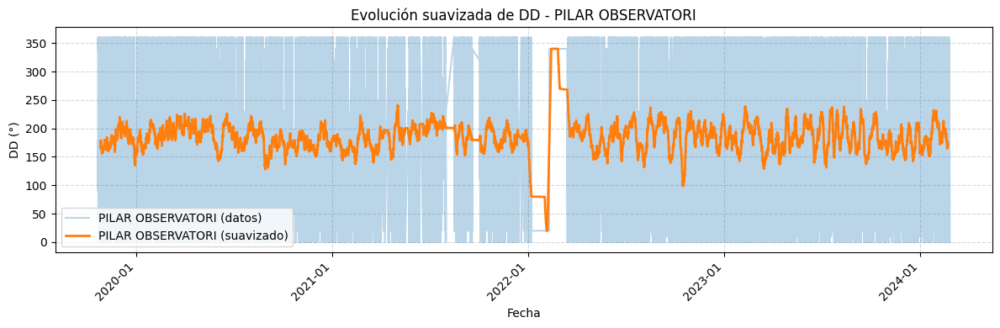

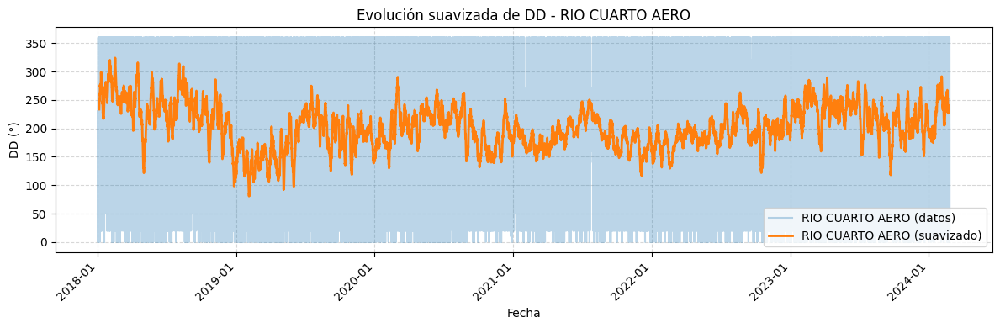

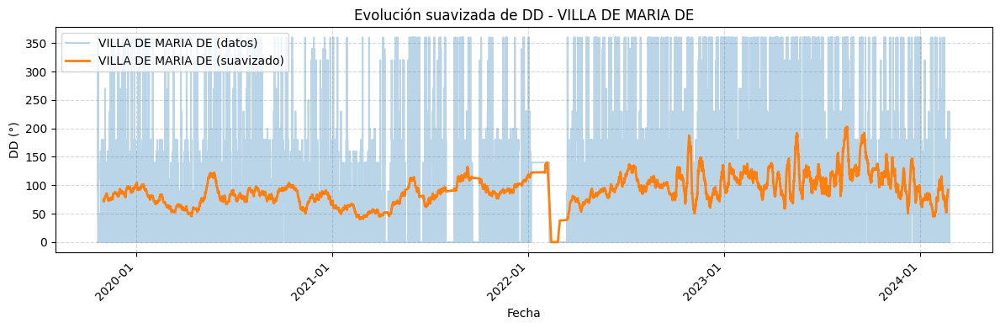

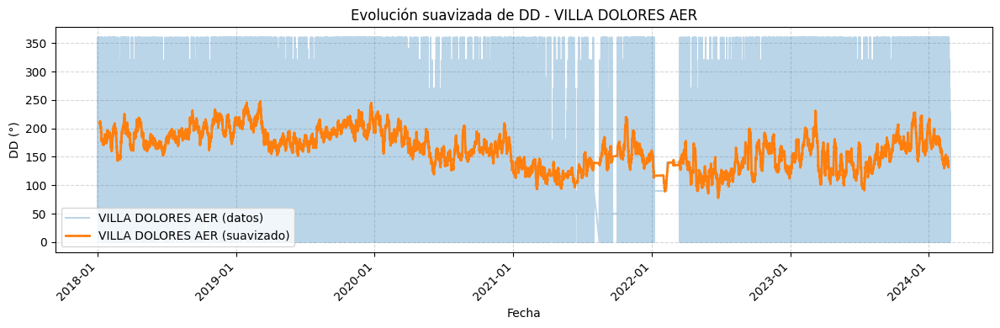

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Diccionario de unidades según columnas
unidades = {
    "TEMP": "°C",
    "HUM": "%",
    "PNM": "hPa",
    "DD": "°",
    "FF": "km/h"
}

# Configuración del eje X
locator = mdates.YearLocator()       # Un tick por año (enero)
formatter = mdates.DateFormatter('%Y-%m')

# Ventana del suavizado → 7 días (168 valores horarios)
window = 24 * 7

for var in variables:
    for est in estaciones:

        df_est = df_interp[df_interp['ESTACION'] == est].copy()

        # Cálculo de la media móvil (suavizado)
        df_est[var + "_smooth"] = df_est[var].rolling(window=window, center=True).mean()

        # Crear figura
        fig, ax = plt.subplots(figsize=(12, 4))

        # Gráfico de datos originales
        ax.plot(df_est['FECHA_HORA'], df_est[var], alpha=0.3, label=f"{est} (datos)")

        # Gráfico suavizado
        ax.plot(df_est['FECHA_HORA'], df_est[var + "_smooth"],
                linewidth=2, label=f"{est} (suavizado)")

        # Eje X uniforme
        ax.xaxis.set_major_locator(locator)
        ax.xaxis.set_major_formatter(formatter)
        plt.setp(ax.get_xticklabels(), rotation=45, ha='right')

        # Unidad correspondiente
        unidad = unidades.get(var, "")
        if unidad:
            ax.set_ylabel(f"{var} ({unidad})")
        else:
            ax.set_ylabel(var)

        ax.set_title(f"Evolución suavizada de {var} - {est}")
        ax.set_xlabel("Fecha")
        ax.legend()
        ax.grid(True, linestyle='--', alpha=0.5)

        plt.tight_layout()
        plt.show()


<Figure size 1000x600 with 0 Axes>

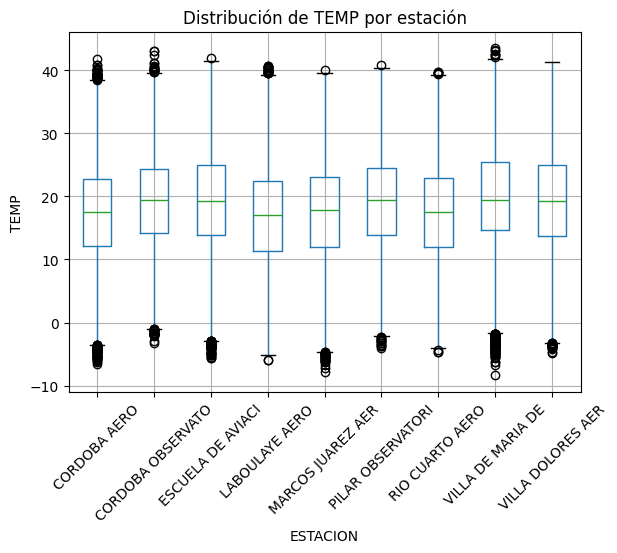

<Figure size 1000x600 with 0 Axes>

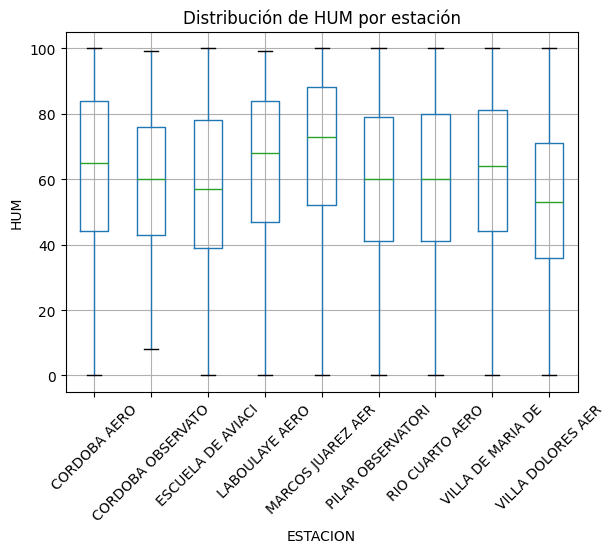

<Figure size 1000x600 with 0 Axes>

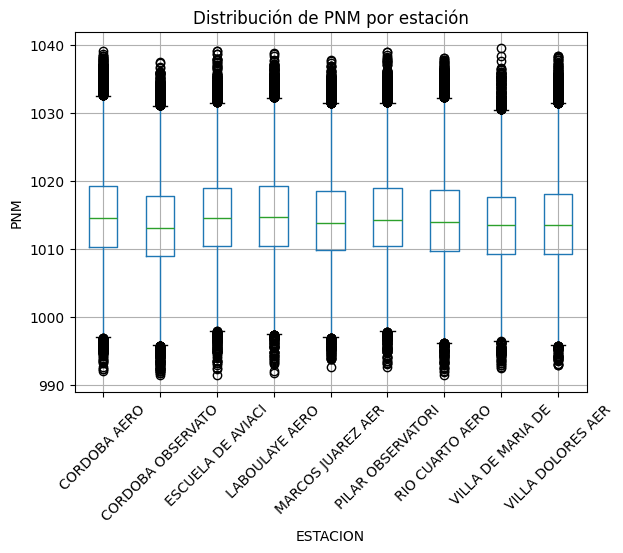

<Figure size 1000x600 with 0 Axes>

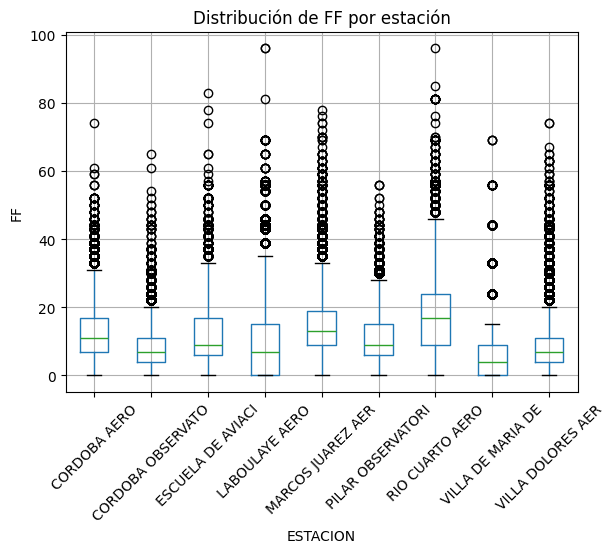

<Figure size 1000x600 with 0 Axes>

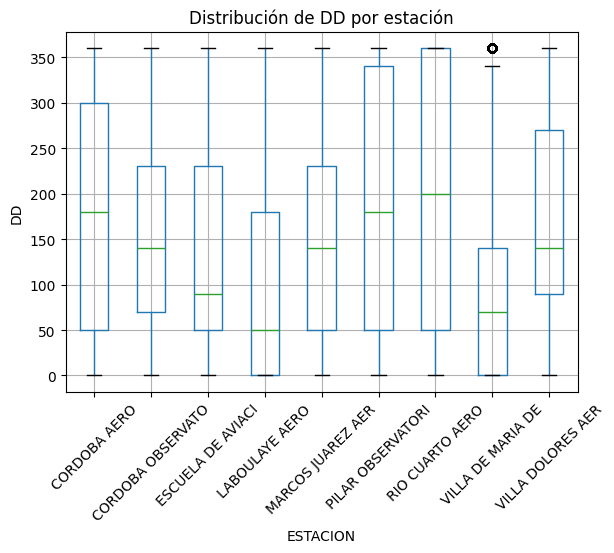

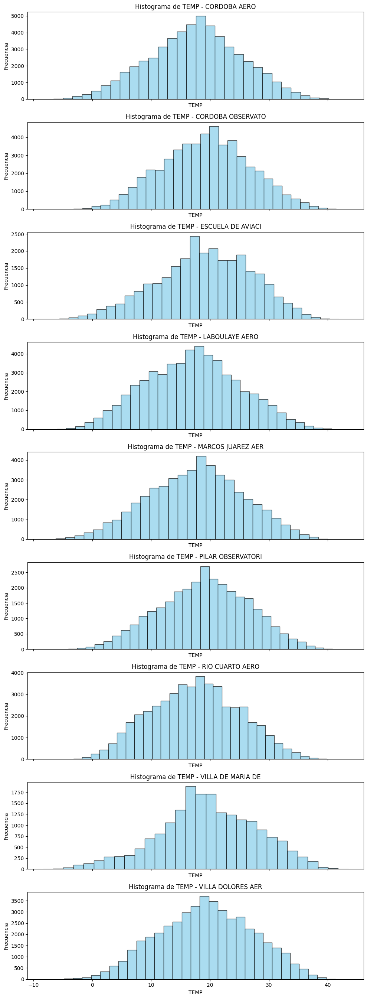

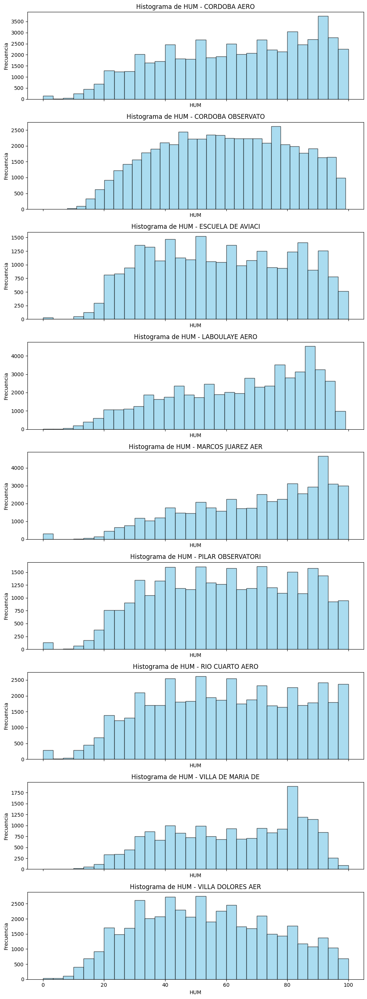

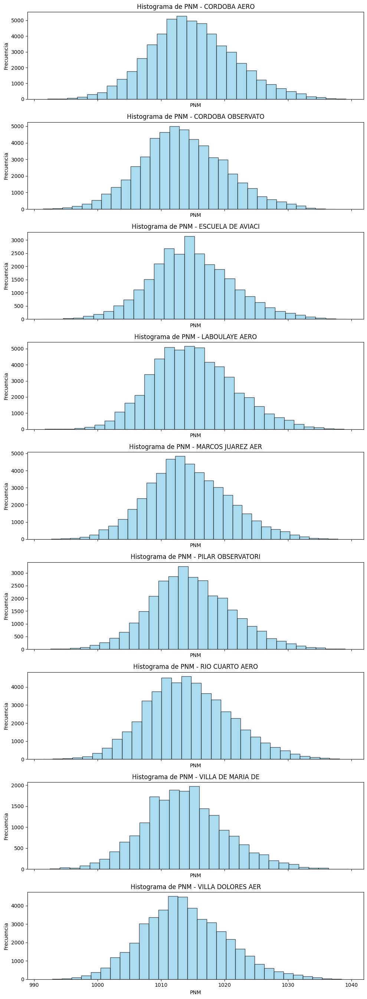

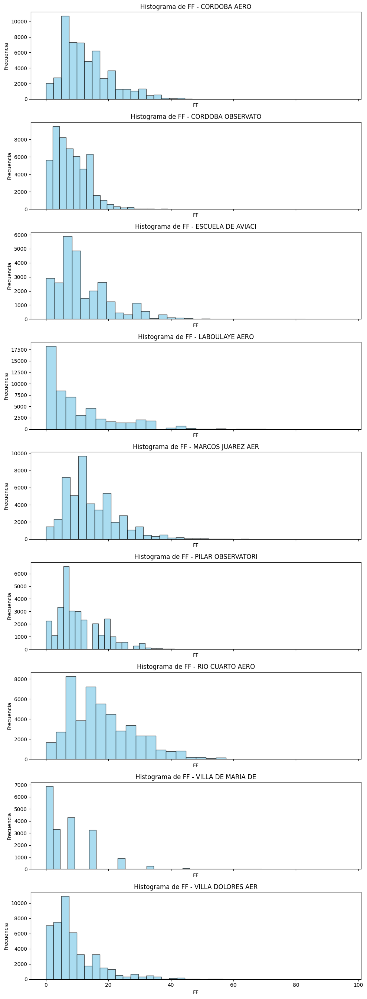

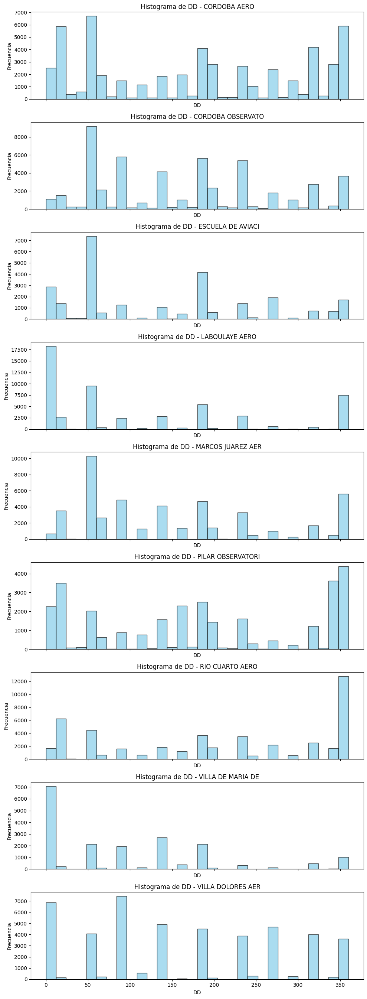

In [ ]:
# Lista de variables meteorológicas a analizar
variables = ['TEMP', 'HUM', 'PNM', 'FF', 'DD']
estaciones = df_interp['ESTACION'].unique()
n = len(estaciones)

# =====================
# 2. Boxplot comparando estaciones
# =====================
for var in variables:
    plt.figure(figsize=(10,6))
    df_interp.boxplot(column=var, by='ESTACION')
    plt.title(f"Distribución de {var} por estación")
    plt.suptitle("")  # para que no ponga un título repetido
    plt.ylabel(var)
    plt.xticks(rotation=45)
    plt.show()

# =====================
# 3. Histogramas por estación
# =====================
for var in variables:
    fig, axes = plt.subplots(n, 1, figsize=(10, 3*n), sharex=True)
    for i, est in enumerate(estaciones):
        df_est = df_interp[df_interp['ESTACION'] == est]
        axes[i].hist(df_est[var], bins=30, alpha=0.7, color="skyblue", edgecolor="black")
        axes[i].set_title(f"Histograma de {var} - {est}")
        axes[i].set_xlabel(var)
        axes[i].set_ylabel("Frecuencia")

    plt.tight_layout()
    plt.show()


Tabla de fechas de inicio y fin por estación

In [ ]:
import pandas as pd

# Nos aseguramos de que FECHA_HORA esté en formato datetime
df_interp['FECHA_HORA'] = pd.to_datetime(df_interp['FECHA_HORA'])

# Agrupamos por estación y calculamos min y max
tabla_periodos = (
    df_interp.groupby('ESTACION')['FECHA_HORA']
    .agg(['min', 'max'])
    .reset_index()
)

# Convertimos a formato YYYY-MM
tabla_periodos['FECHA_INICIO'] = tabla_periodos['min'].dt.strftime('%Y-%m')
tabla_periodos['FECHA_FIN'] = tabla_periodos['max'].dt.strftime('%Y-%m')

# Seleccionamos solo columnas limpias
tabla_periodos = tabla_periodos[['ESTACION', 'FECHA_INICIO', 'FECHA_FIN']]

# Mostramos tabla
print(tabla_periodos)


            ESTACION FECHA_INICIO FECHA_FIN
0       CORDOBA AERO      2018-01   2024-02
1  CORDOBA OBSERVATO      2018-01   2024-02
2  ESCUELA DE AVIACI      2019-10   2024-02
3     LABOULAYE AERO      2018-01   2024-02
4  MARCOS JUAREZ AER      2018-01   2024-02
5  PILAR OBSERVATORI      2019-10   2024-02
6    RIO CUARTO AERO      2018-01   2024-02
7  VILLA DE MARIA DE      2019-10   2024-02
8  VILLA DOLORES AER      2018-01   2024-02


# **Sexto paso: AGRUPAR POR MES LOS DATOS HORARIOS**

Los datos de ENARGAS están por mes, por lo que se debe agrupar los datos del SMN que están por hora en cada estación.

Para decidir qué criterio usar para agrupar, normalmente se usa:

Media (mean): para variables como temperatura, humedad, velocidad del viento, presión.

Dirección del viento (DD): como es angular, se puede usar promedio vectorial (media circular). Pero también se podría considerar para menor complicación usar simplemente la media aritmética de los ángulos convertidos a vectoriales (como se hizo para interpolar).



In [ ]:
# Asegurar que FECHA_HORA está en datetime
df_interp['FECHA_HORA'] = pd.to_datetime(df_interp['FECHA_HORA'])

# Crear columna mes-año
df_interp['MES_ANIO'] = df_interp['FECHA_HORA'].dt.to_period('M')

# Función para promedio circular para DD
import numpy as np

def promedio_circular(angles_deg):
    angles_rad = np.deg2rad(angles_deg)
    sin_mean = np.mean(np.sin(angles_rad))
    cos_mean = np.mean(np.cos(angles_rad))
    mean_angle = np.rad2deg(np.arctan2(sin_mean, cos_mean)) % 360
    return mean_angle

# Agrupar por estación y mes-año
df_mensual = df_interp.groupby(['ESTACION', 'MES_ANIO']).agg({
    'TEMP': 'mean',
    'HUM': 'mean',
    'PNM': 'mean',
    'FF': 'mean',
    'DD': promedio_circular
}).reset_index()

# Convertir MES_ANIO a timestamp (primer día del mes)
df_mensual['MES_ANIO'] = df_mensual['MES_ANIO'].dt.to_timestamp()

print(df_mensual.head())


       ESTACION   MES_ANIO       TEMP        HUM          PNM         FF  \
0  CORDOBA AERO 2018-01-01  22.656729  62.368102  1010.835666  12.498340   
1  CORDOBA AERO 2018-02-01  22.106250  64.540179  1012.276786  12.275251   
2  CORDOBA AERO 2018-03-01  20.366935  54.670699  1011.858199  14.696237   
3  CORDOBA AERO 2018-04-01  20.193056  72.513889  1014.008611  12.994675   
4  CORDOBA AERO 2018-05-01  14.879906  73.576613  1016.783871  12.405602   

           DD  
0  354.023057  
1  356.224609  
2   15.446573  
3   36.312860  
4  359.299821  


# **Séptimo paso: Guardar el dataset curado y agrupado en Excel, como así también el interpolado solamente en Drive**





In [ ]:
output_path = '/content/drive/MyDrive/PS/BASE_DATO/DF_SMN_LIMPIO_MENSUAL.xlsx'
df_mensual.to_excel(output_path, index=False)
print(f"Archivo guardado en: {output_path}")


Archivo guardado en: /content/drive/MyDrive/PS/BASE_DATO/DF_SMN_LIMPIO_MENSUAL.xlsx


In [ ]:
# Guardar df_interp (datos horarios del SMN antes de agrupar)
output_path = '/content/drive/MyDrive/PS/BASE_DATO/DF_SMN_HORARIO.xlsx'
df_interp.to_excel(output_path, index=False)
print(f"Archivo guardado en: {output_path}")


Archivo guardado en: /content/drive/MyDrive/PS/BASE_DATO/DF_SMN_HORARIO.xlsx


# **Octavo paso: INFORMACIÓN Y GRÁFICOS DEL ARCHIVO FINAL CON LOS DATOS DEL SMN LIMPIOS MENSUALES**

Repetir nuevamente el código para extraer información, pero esta vez sobre el archivo DF_SMN_LIMPIO_MENSUAL.
También se realizan:

-Gráficos de caja: Para detectar asimetrías y valores extremos.

-Gráfico de líneas: Sirve para ver cómo se comporta una variable a lo largo del tiempo, tendencia temporal.

-Histograma: Para detectar asimetrías y ver frecuencias absolutas.

-Histograma/KDE: Gráfico de densidad de Kernel, que es como un histograma suavizado, representa los datos mediante una curva de densidad de probabilidad, sirve para ver si los datos son unimodales (una campana) o multimodales (dos picos, etc).





In [ ]:

# Cargar el archivo mensual
file_mensual = '/content/drive/MyDrive/PS/BASE_DATO/DF_SMN_LIMPIO_MENSUAL.xlsx'
df_mensual = pd.read_excel(file_mensual)

# --- Chequeo de df_mensual ---
print("===== CHEQUEO DE DF_MENSUAL (AGRUPADO POR MES) =====")
print("Dimensiones:", df_mensual.shape)

print("\nTipos de datos y nulos por columna:")
print(df_mensual.info())

print("\nValores nulos por columna:")
print(df_mensual.isna().sum())

print("\nPorcentaje de nulos por columna:")
print((df_mensual.isna().mean() * 100).round(2))

print("\nEstadísticas descriptivas:")
print(df_mensual.describe(include='all'))

print("\nPrimeras filas:")
print(df_mensual.head())


===== CHEQUEO DE DF_MENSUAL (AGRUPADO POR MES) =====
Dimensiones: (603, 7)

Tipos de datos y nulos por columna:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 603 entries, 0 to 602
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   ESTACION  603 non-null    object        
 1   MES_ANIO  603 non-null    datetime64[ns]
 2   TEMP      603 non-null    float64       
 3   HUM       603 non-null    float64       
 4   PNM       603 non-null    float64       
 5   FF        603 non-null    float64       
 6   DD        603 non-null    float64       
dtypes: datetime64[ns](1), float64(5), object(1)
memory usage: 33.1+ KB
None

Valores nulos por columna:
ESTACION    0
MES_ANIO    0
TEMP        0
HUM         0
PNM         0
FF          0
DD          0
dtype: int64

Porcentaje de nulos por columna:
ESTACION    0.0
MES_ANIO    0.0
TEMP        0.0
HUM         0.0
PNM         0.0
FF          0.0
DD          0.0
dtype: f

/tmp/ipython-input-2677832226.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")


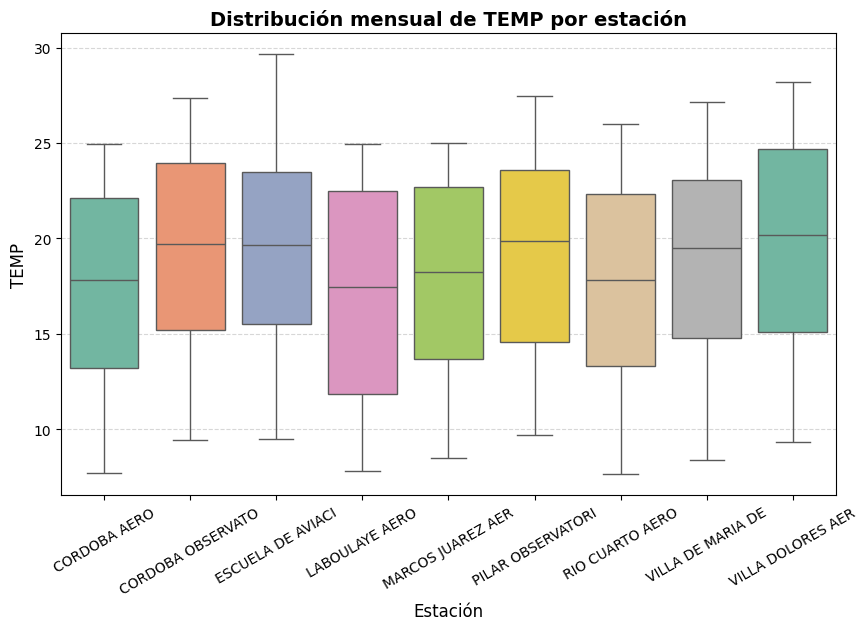

/tmp/ipython-input-2677832226.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")


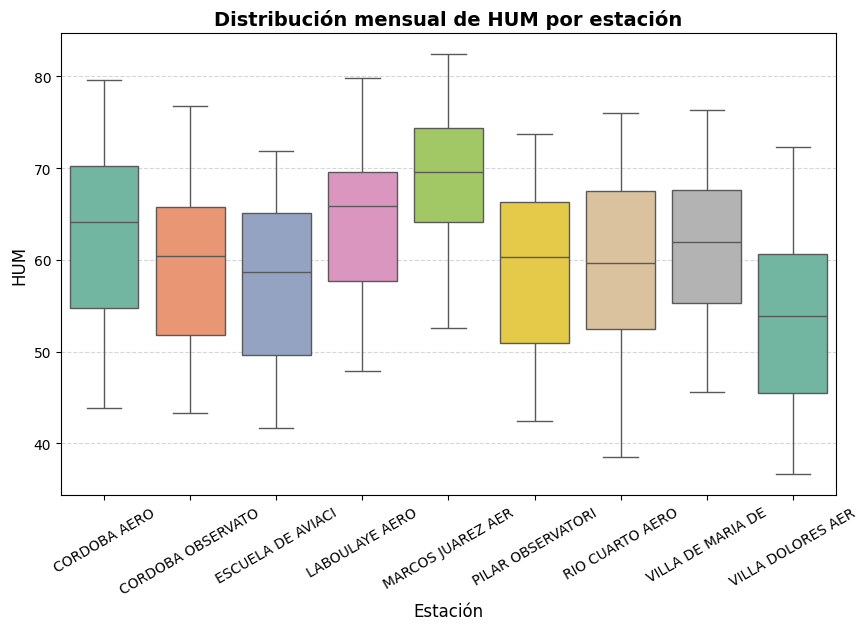

/tmp/ipython-input-2677832226.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")


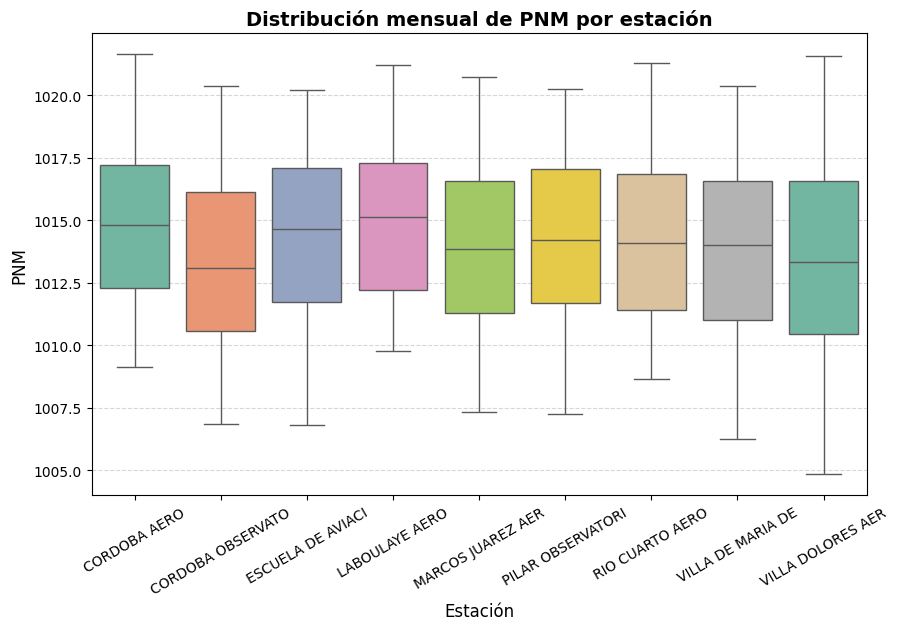

/tmp/ipython-input-2677832226.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")


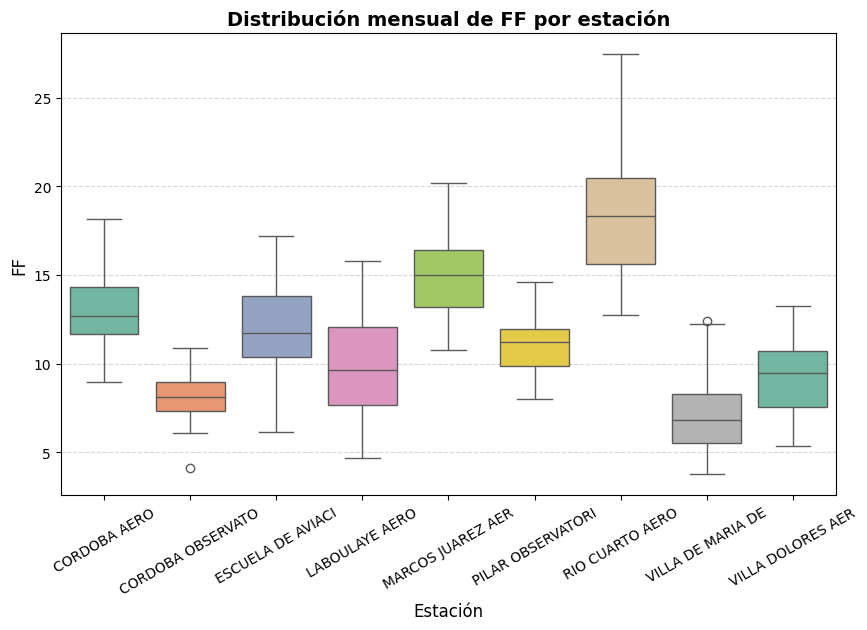

/tmp/ipython-input-2677832226.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")


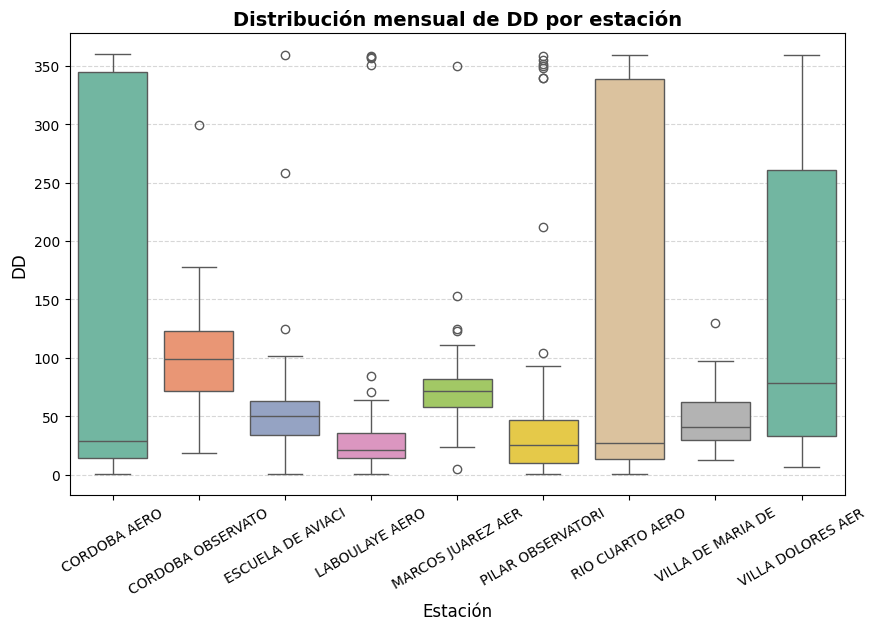

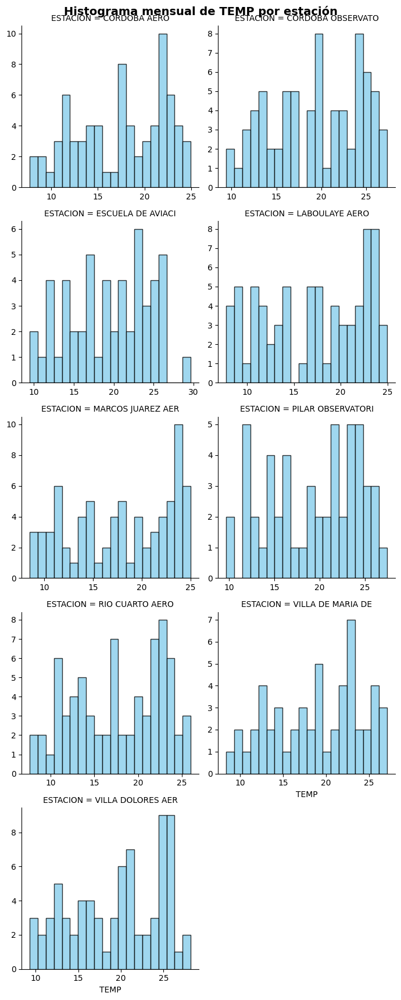

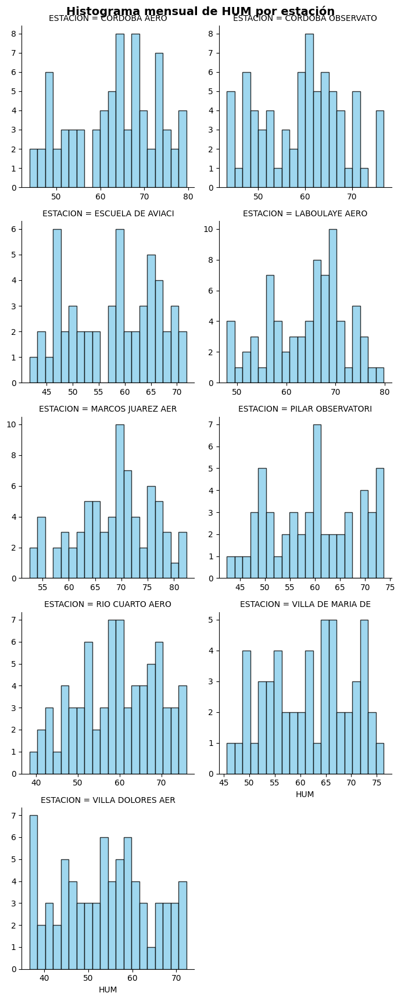

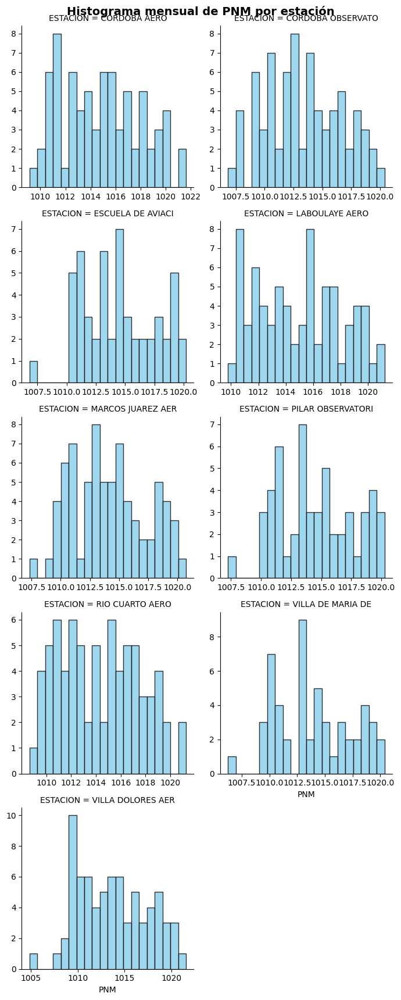

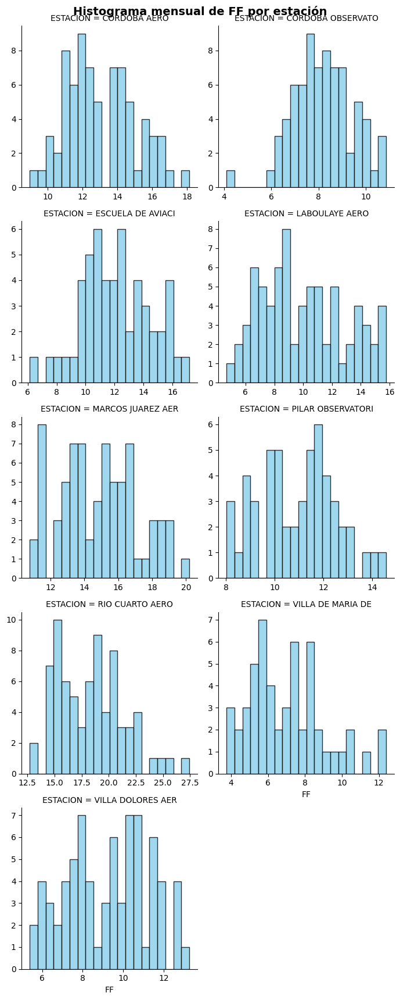

...

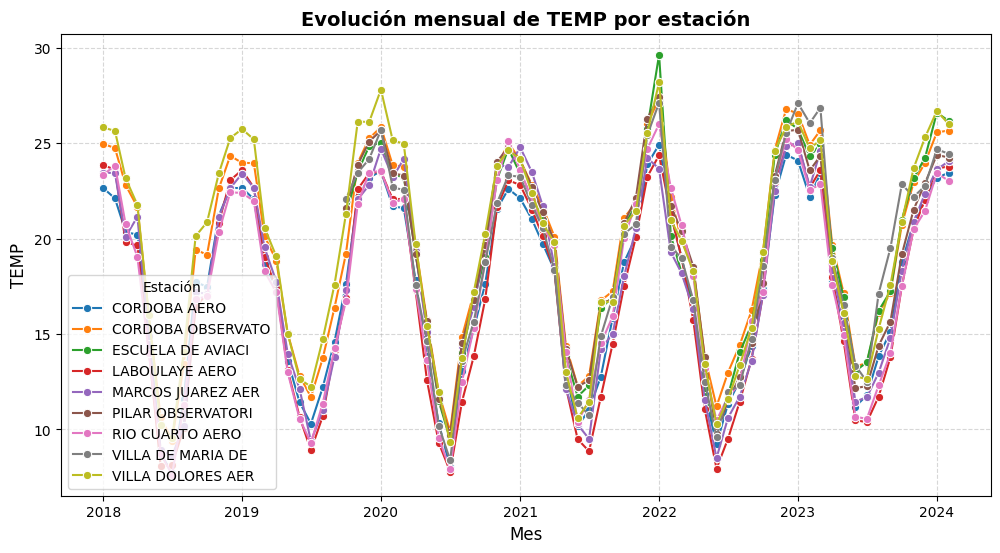

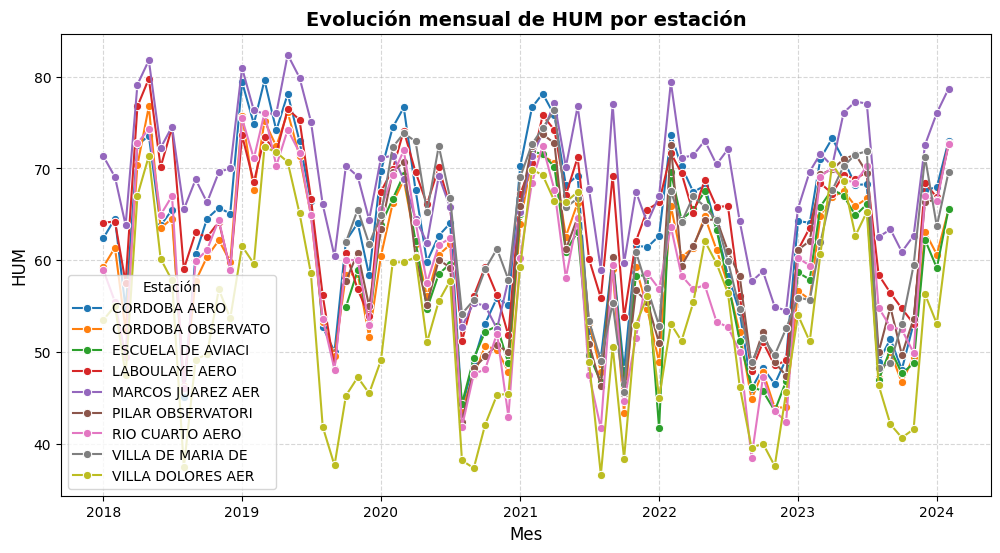

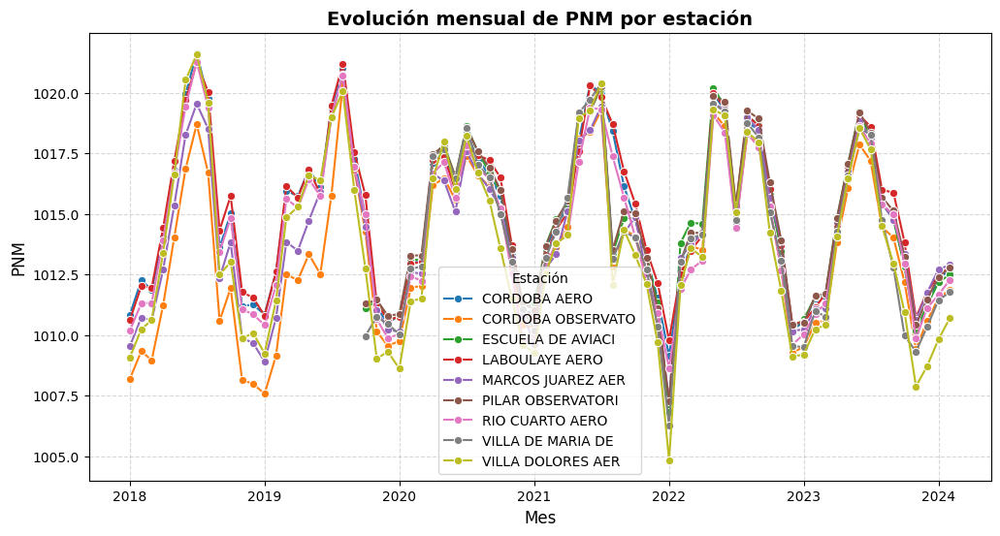

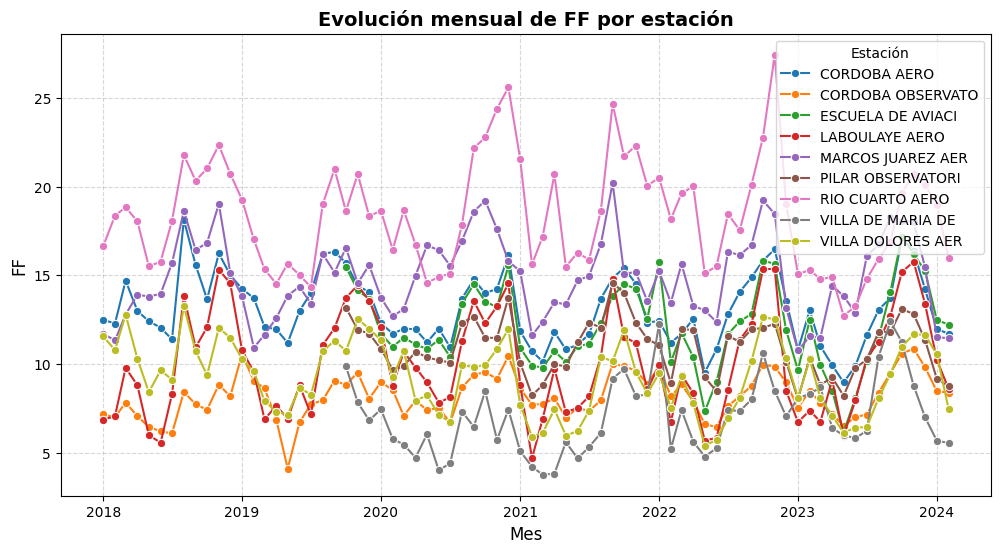

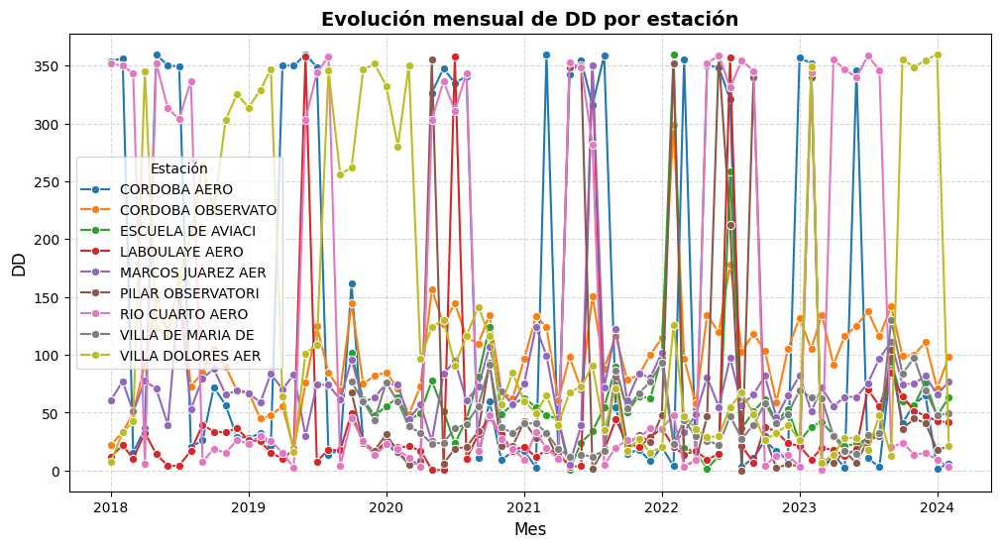

In [ ]:
# =====================
# Cargar datos mensuales
# =====================
df_mensual = pd.read_excel("/content/drive/MyDrive/PS/BASE_DATO/DF_SMN_LIMPIO_MENSUAL.xlsx")

# Asegurar que la columna de fecha sea datetime
df_mensual['MES_ANIO'] = pd.to_datetime(df_mensual['MES_ANIO'])

# Extraer mes y año para etiquetar
df_mensual['MES'] = df_mensual['MES_ANIO'].dt.to_period('M')

variables = ['TEMP', 'HUM', 'PNM', 'FF', 'DD']
estaciones = df_mensual['ESTACION'].unique()
n = len(estaciones)

# =====================
# 1. Boxplot comparando estaciones
# =====================
for var in variables:
    plt.figure(figsize=(10,6))
    sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")
    plt.title(f"Distribución mensual de {var} por estación", fontsize=14, weight="bold")
    plt.ylabel(var, fontsize=12)
    plt.xlabel("Estación", fontsize=12)
    plt.xticks(rotation=30)
    plt.grid(axis="y", linestyle="--", alpha=0.5)
    plt.show()

# =====================
# 2. Histogramas por estación
# =====================
for var in variables:
    g = sns.FacetGrid(df_mensual, col="ESTACION", col_wrap=2, height=3.5, sharex=False, sharey=False)
    g.map(plt.hist, var, bins=20, color="skyblue", edgecolor="black", alpha=0.8)
    g.fig.suptitle(f"Histograma mensual de {var} por estación", fontsize=14, weight="bold")
    g.fig.tight_layout()
    plt.show()

# =====================
# 3. Gráficos de líneas (tendencia mensual)
# =====================
for var in variables:
    plt.figure(figsize=(12,6))
    sns.lineplot(data=df_mensual, x="MES_ANIO", y=var, hue="ESTACION", marker="o", palette="tab10")
    plt.title(f"Evolución mensual de {var} por estación", fontsize=14, weight="bold")
    plt.xlabel("Mes", fontsize=12)
    plt.ylabel(var, fontsize=12)
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.legend(title="Estación")
    plt.show()

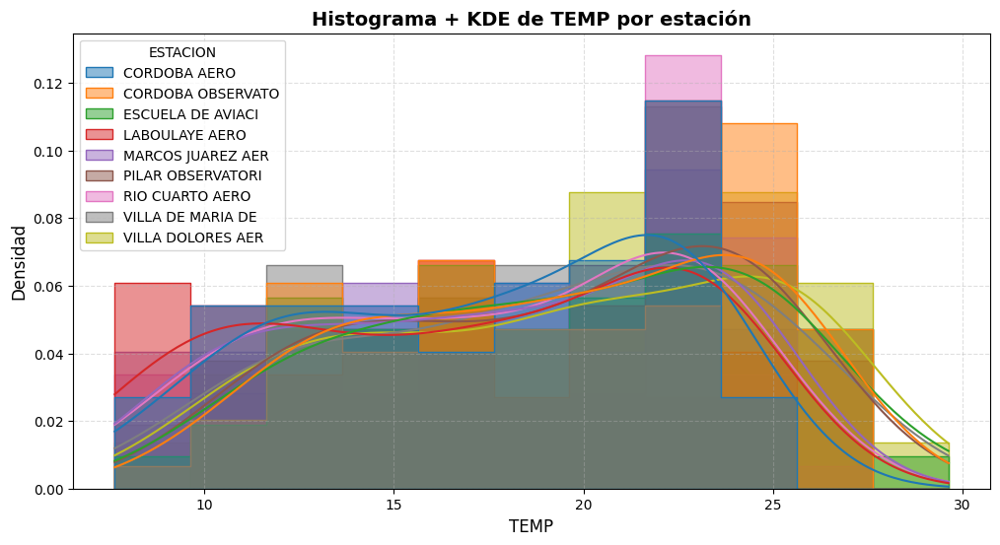

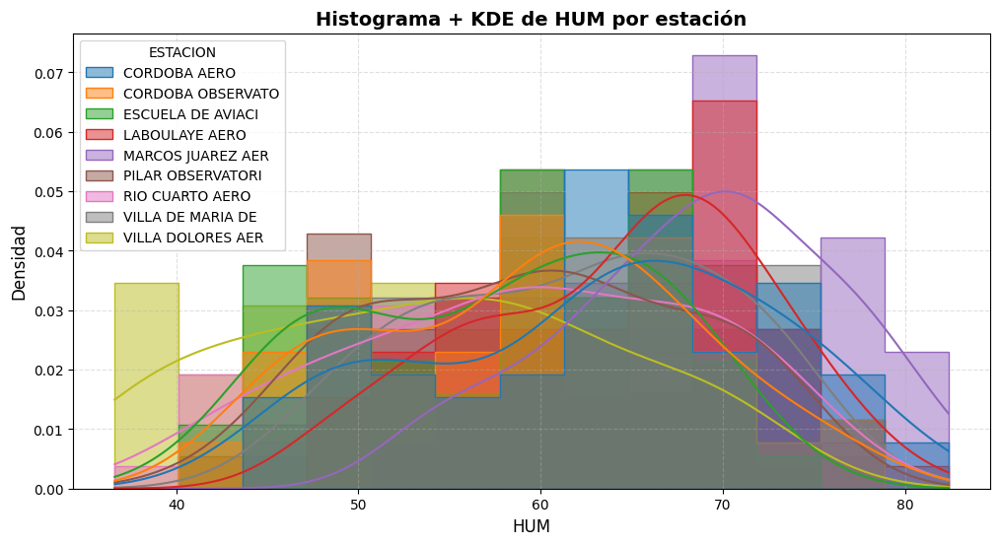

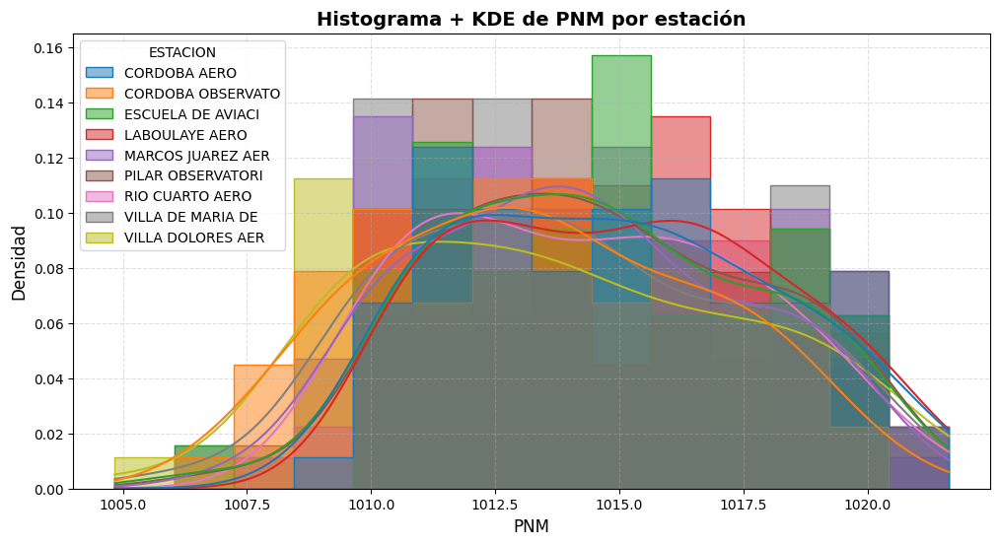

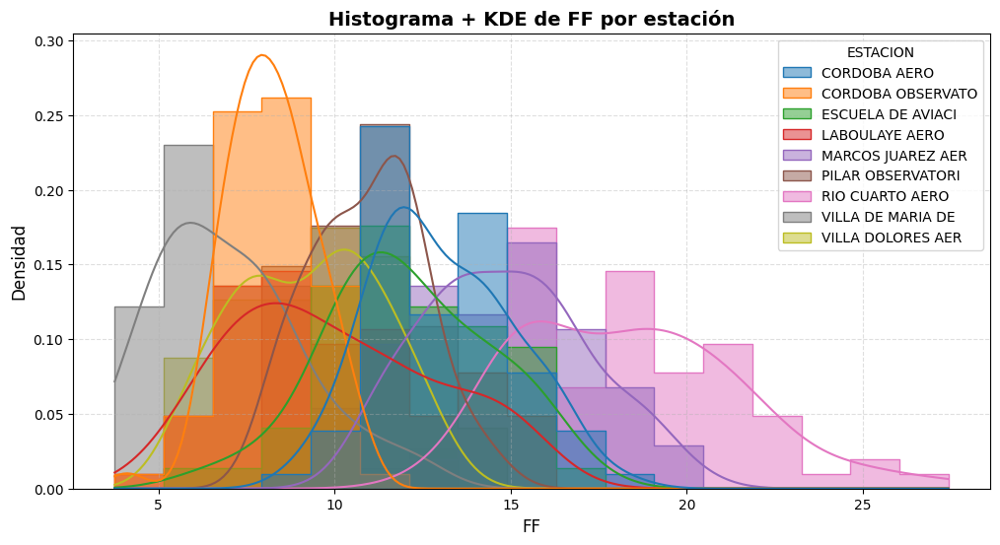

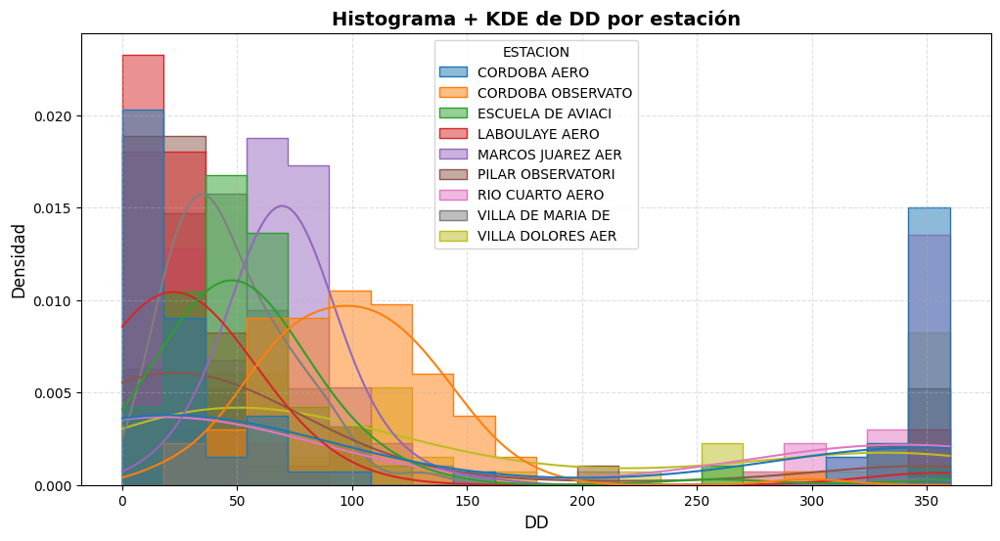

In [ ]:


variables = ['TEMP', 'HUM', 'PNM', 'FF', 'DD']
estaciones = df_mensual['ESTACION'].unique()

for var in variables:
    plt.figure(figsize=(12,6))
    sns.histplot(
        data=df_mensual,
        x=var,
        hue="ESTACION",   # cada estación con distinto color
        kde=True,         # agrega la curva KDE
        element="step",   # estilo de las barras
        stat="density",   # normaliza para que el área total sea 1
        common_norm=False, # evita que se mezclen densidades entre estaciones
        palette="tab10",
        alpha=0.5
    )
    plt.title(f"Histograma + KDE de {var} por estación", fontsize=14, weight="bold")
    plt.xlabel(var, fontsize=12)
    plt.ylabel("Densidad", fontsize=12)
    plt.grid(True, linestyle="--", alpha=0.4)
    plt.show()


/tmp/ipython-input-795394253.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")


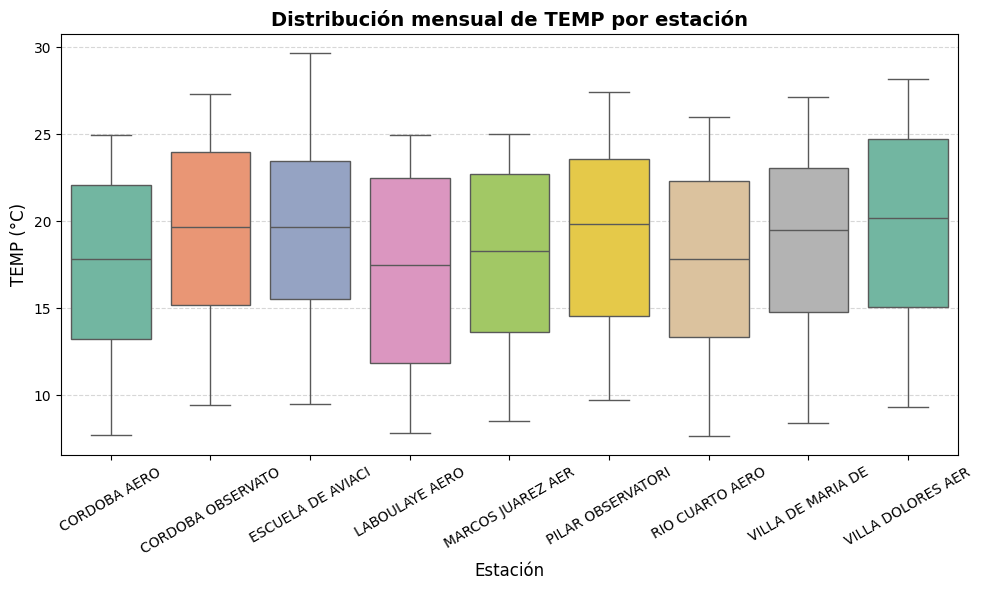

/tmp/ipython-input-795394253.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")


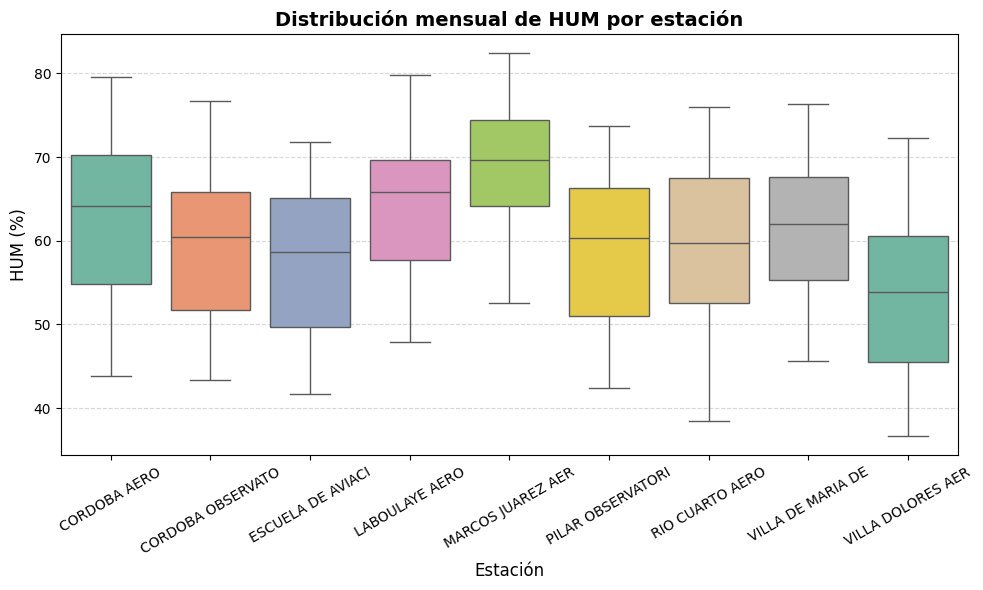

/tmp/ipython-input-795394253.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")


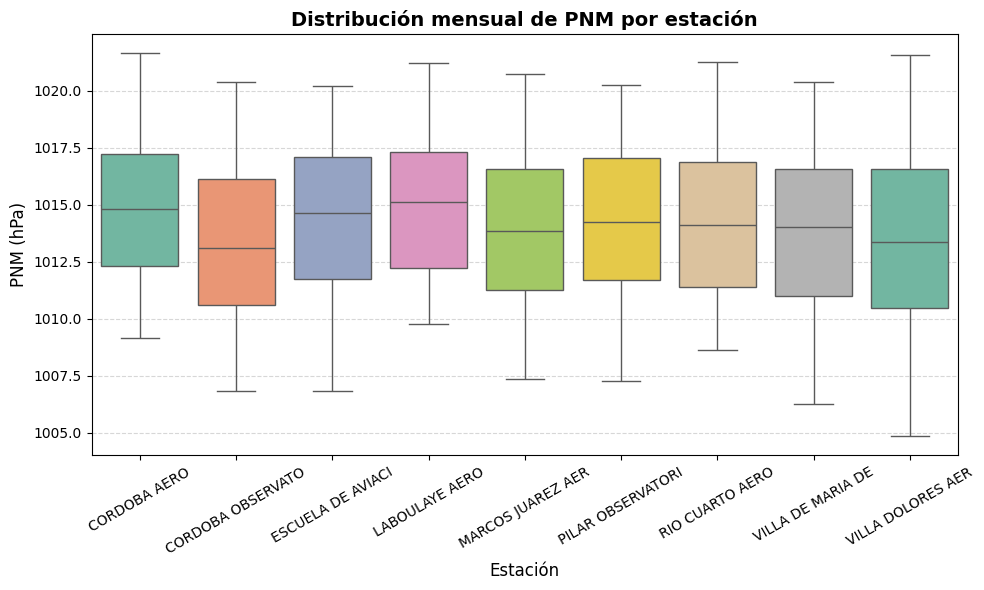

/tmp/ipython-input-795394253.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")


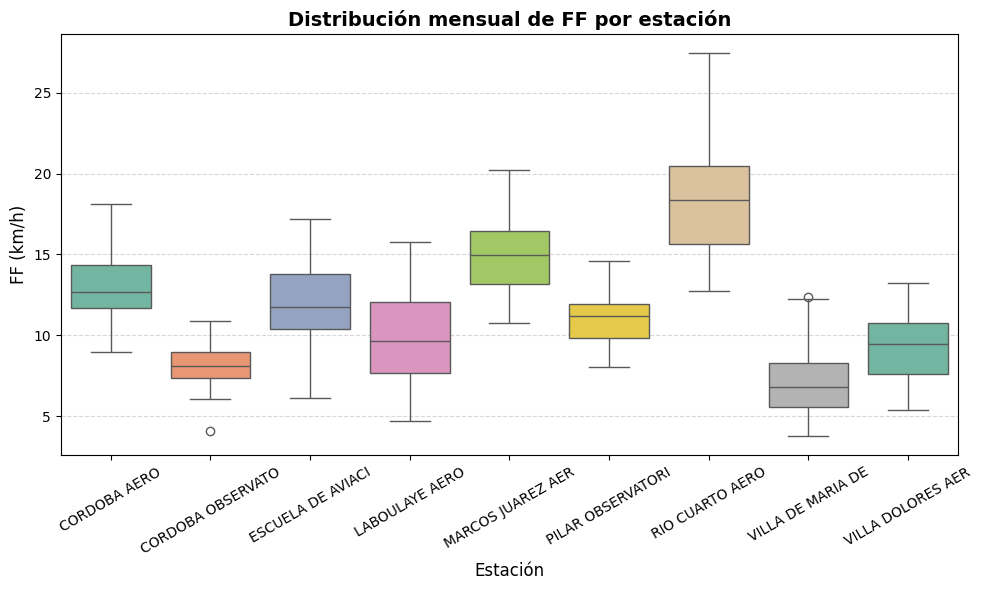

/tmp/ipython-input-795394253.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")


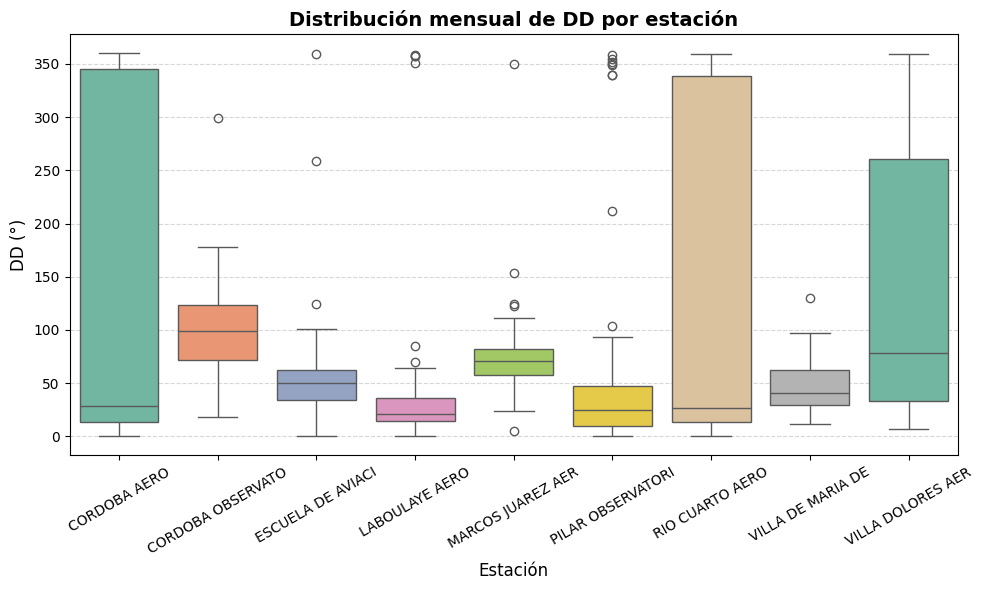

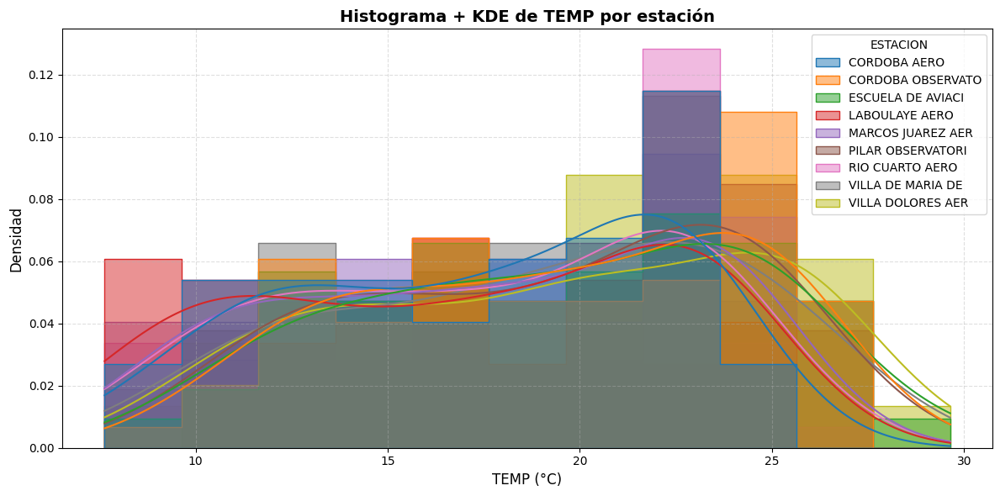

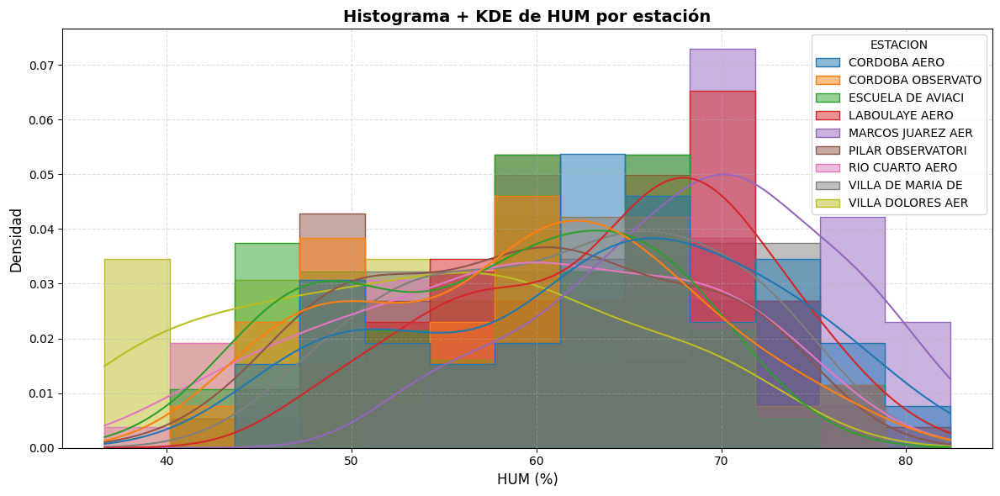

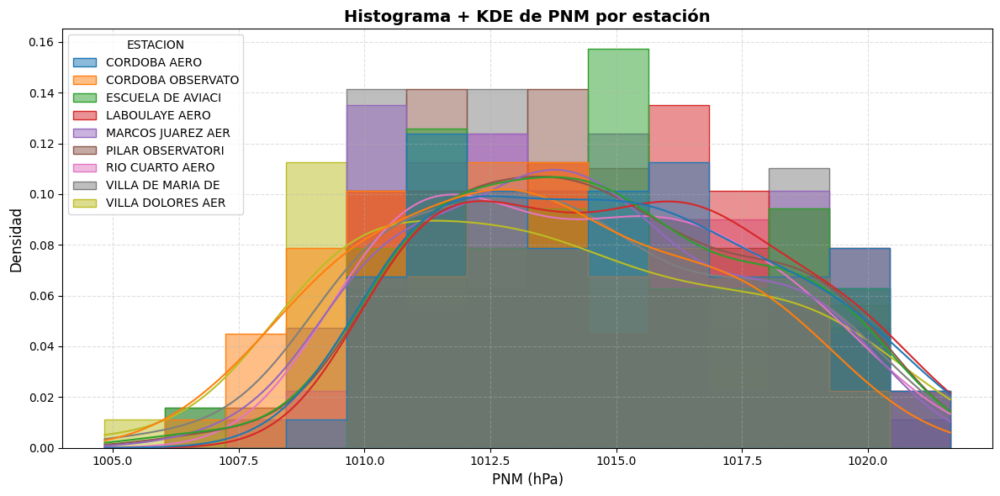

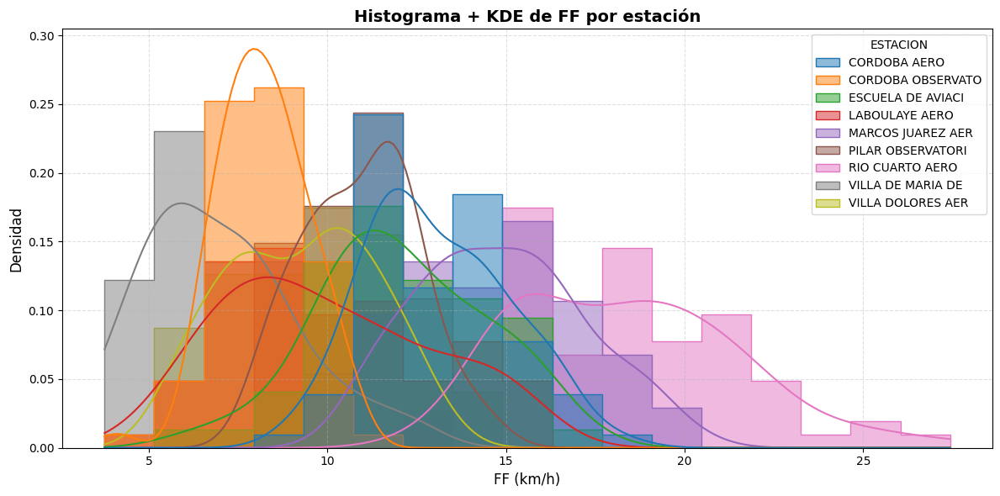

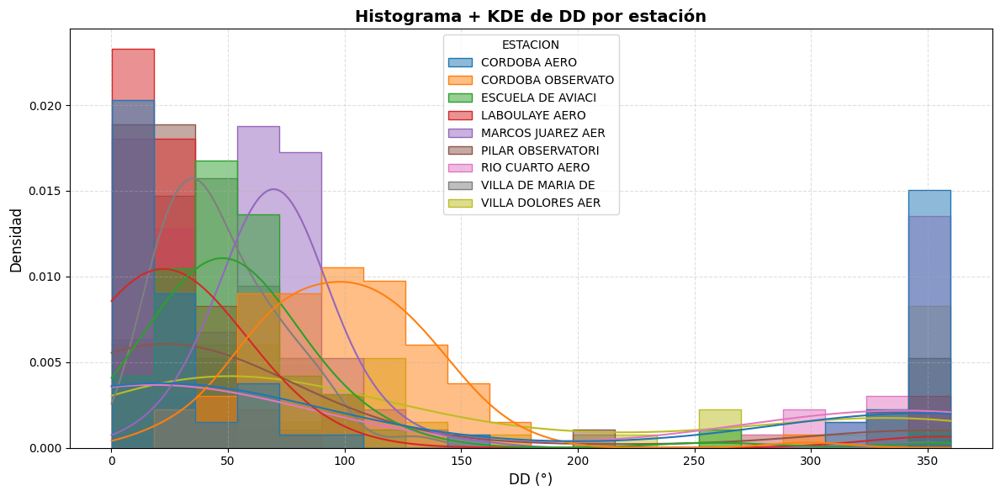

In [ ]:
import matplotlib.dates as mdates
import seaborn as sns
import matplotlib.pyplot as plt

# =====================
# Diccionario de unidades
# =====================
unidades = {
    "TEMP": "°C",
    "HUM": "%",
    "PNM": "hPa",
    "FF": "km/h",  # ajustar si tus datos están en m/s
    "DD": "°"
}

variables = ['TEMP', 'HUM', 'PNM', 'FF', 'DD']
estaciones = df_mensual['ESTACION'].unique()

# =====================
# 1. Boxplot comparando estaciones
# =====================
for var in variables:
    plt.figure(figsize=(10,6))
    sns.boxplot(data=df_mensual, x="ESTACION", y=var, palette="Set2")

    unidad = unidades.get(var, "")
    plt.title(f"Distribución mensual de {var} por estación", fontsize=14, weight="bold")

    if unidad:
        plt.ylabel(f"{var} ({unidad})", fontsize=12)
    else:
        plt.ylabel(var, fontsize=12)

    plt.xlabel("Estación", fontsize=12)
    plt.xticks(rotation=30)
    plt.grid(axis="y", linestyle="--", alpha=0.5)
    plt.tight_layout()
    plt.show()







# =====================
# 4. Histogramas con KDE por estación
# =====================
for var in variables:
    plt.figure(figsize=(12,6))

    unidad = unidades.get(var, "")

    sns.histplot(
        data=df_mensual,
        x=var,
        hue="ESTACION",
        kde=True,
        element="step",
        stat="density",
        common_norm=False,
        palette="tab10",
        alpha=0.5
    )

    plt.title(f"Histograma + KDE de {var} por estación", fontsize=14, weight="bold")

    if unidad:
        plt.xlabel(f"{var} ({unidad})", fontsize=12)
    else:
        plt.xlabel(var, fontsize=12)

    plt.ylabel("Densidad", fontsize=12)
    plt.grid(True, linestyle="--", alpha=0.4)
    plt.tight_layout()
    plt.show()


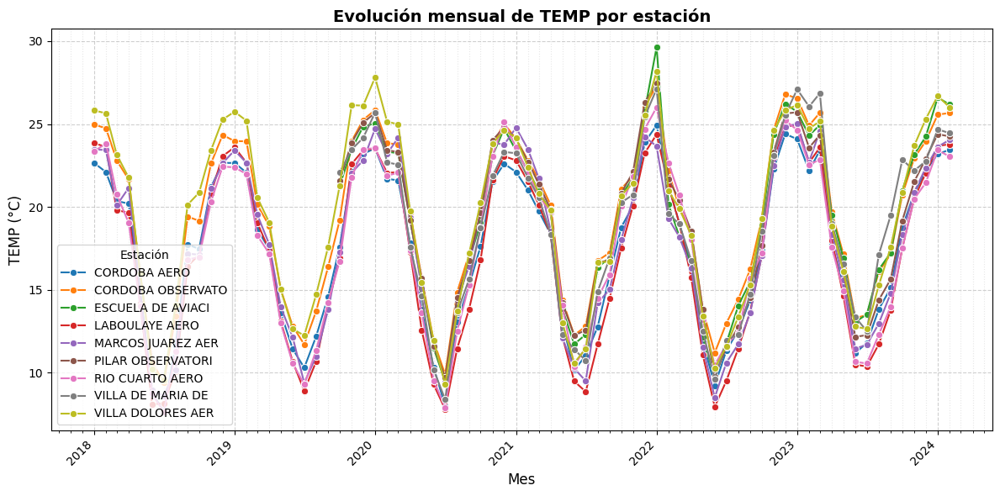

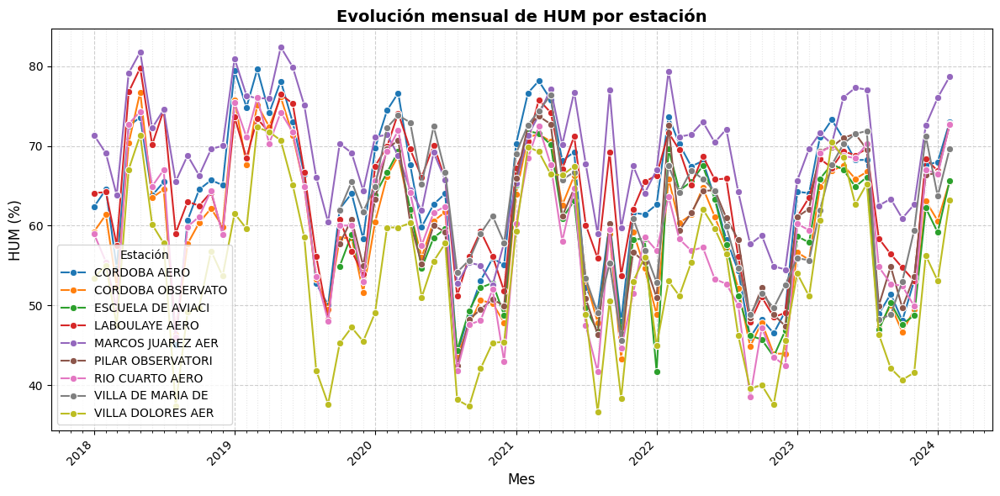

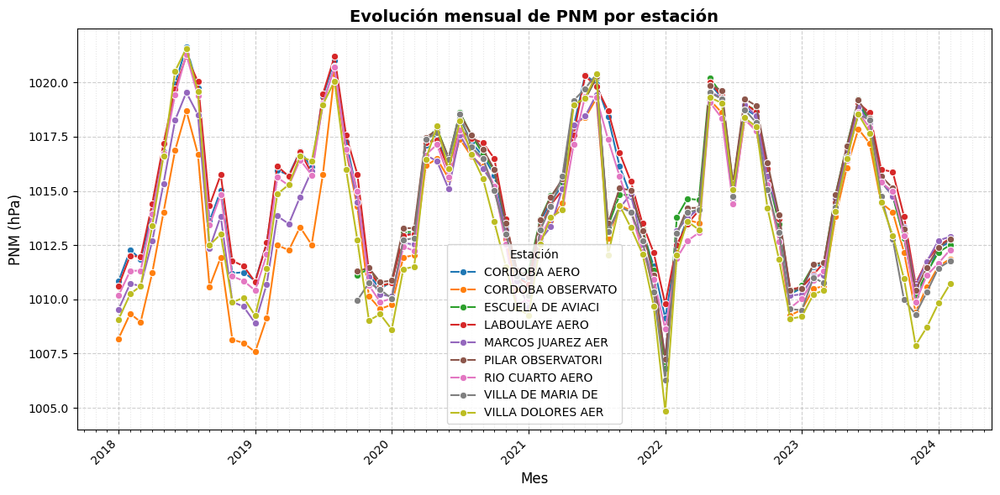

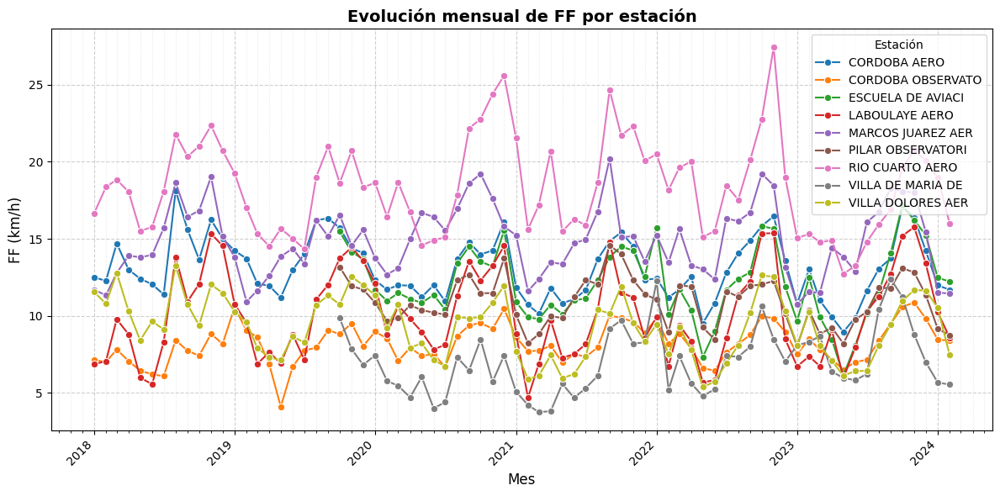

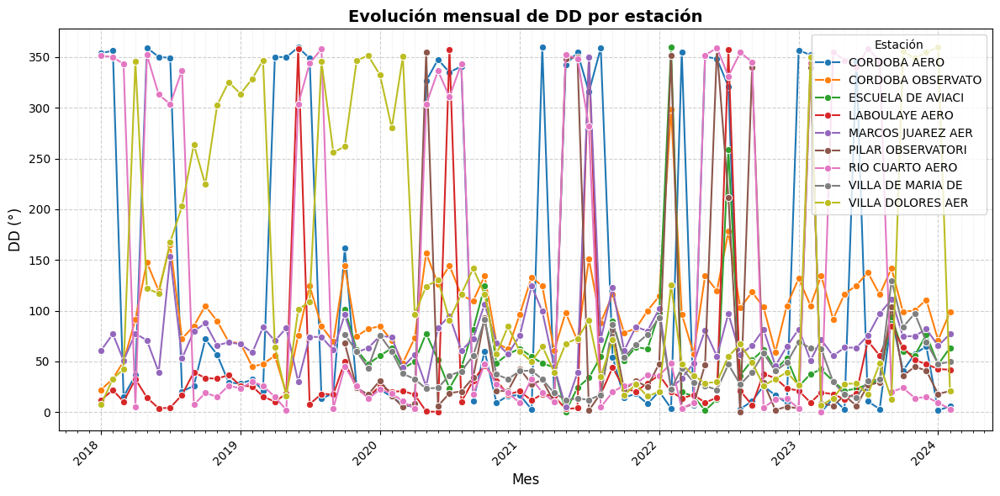

In [ ]:
import matplotlib.dates as mdates

# Localizadores y formateador para el eje X
locator_major = mdates.YearLocator()          # Ticks principales: años
locator_minor = mdates.MonthLocator()         # Ticks secundarios: meses
formatter = mdates.DateFormatter('%Y')        # Formato para mostrar solo el año

# =====================
# 3. Gráficos de líneas (tendencia mensual)
# =====================
for var in variables:
    plt.figure(figsize=(12,6))

    ax = sns.lineplot(
        data=df_mensual,
        x="MES_ANIO",
        y=var,
        hue="ESTACION",
        marker="o",
        palette="tab10"
    )

    unidad = unidades.get(var, "")

    # Título y ejes
    plt.title(f"Evolución mensual de {var} por estación", fontsize=14, weight="bold")
    plt.xlabel("Mes", fontsize=12)

    if unidad:
        plt.ylabel(f"{var} ({unidad})", fontsize=12)
    else:
        plt.ylabel(var, fontsize=12)

    # --- Ajuste del eje X ---
    ax.xaxis.set_major_locator(locator_major)
    ax.xaxis.set_major_formatter(formatter)

    ax.xaxis.set_minor_locator(locator_minor)

    # Grillas mayor y menor
    ax.grid(True, which="major", linestyle="--", alpha=0.6)
    ax.grid(True, which="minor", linestyle=":", alpha=0.3)

    # Rotación de etiquetas
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right")

    plt.legend(title="Estación")
    plt.tight_layout()
    plt.show()


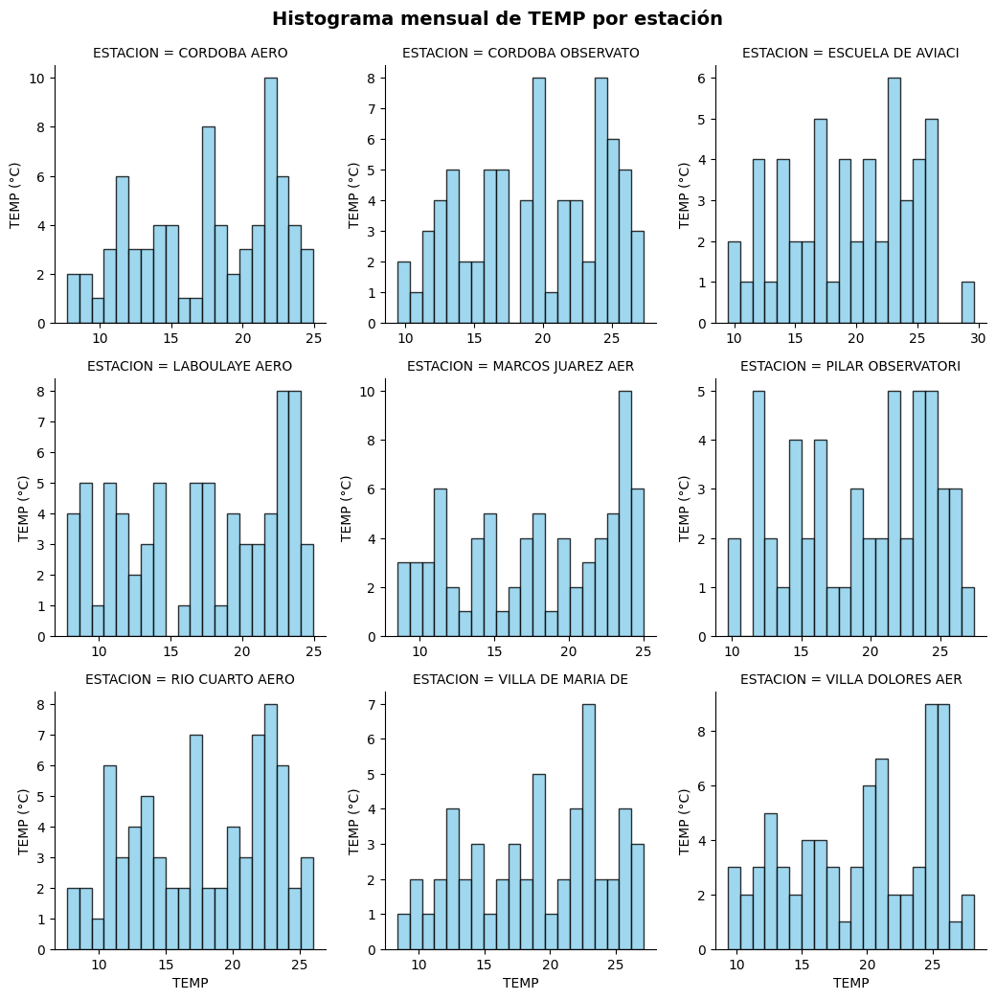

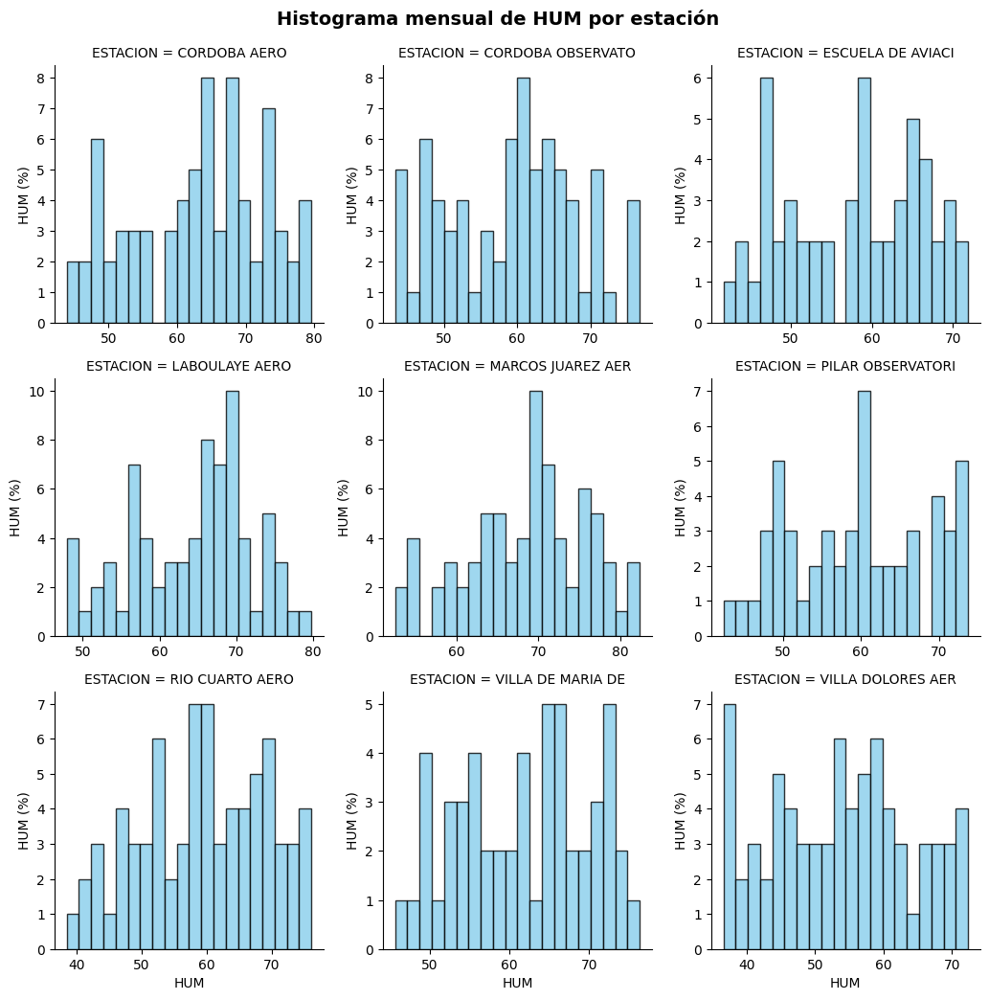

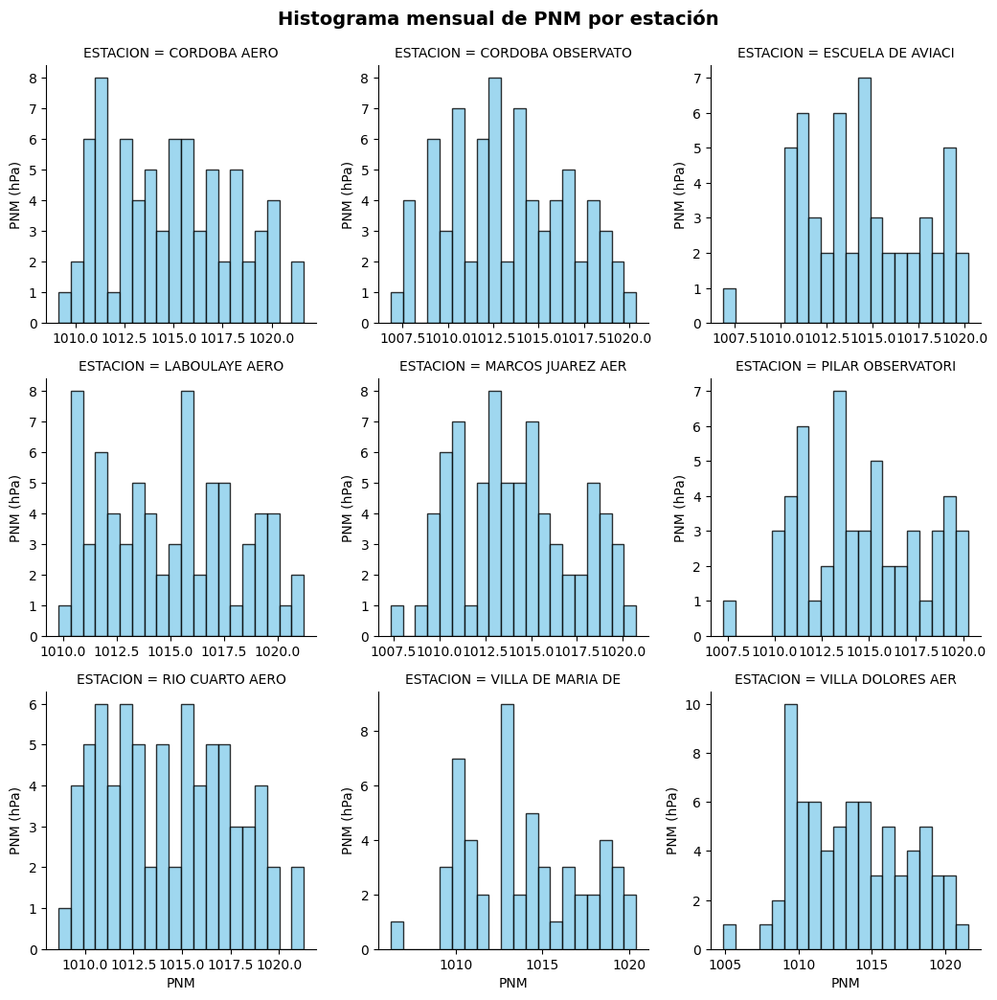

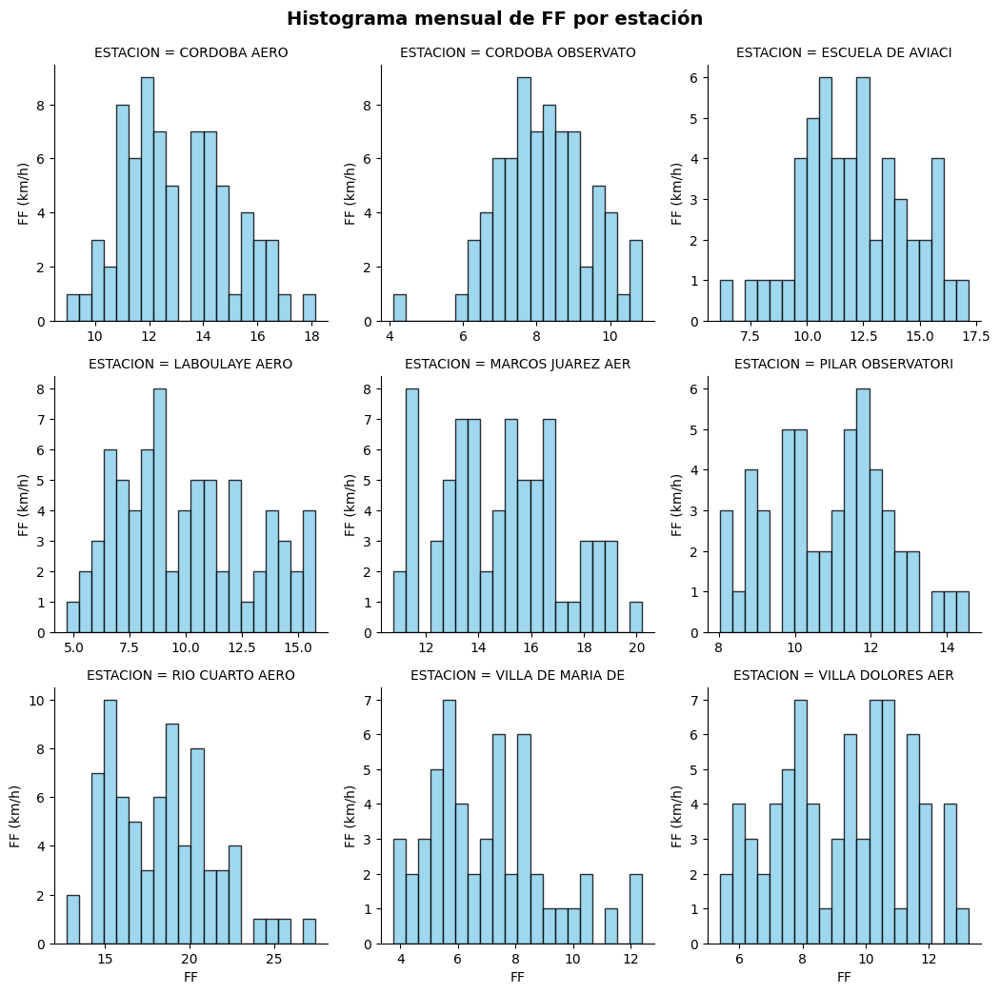

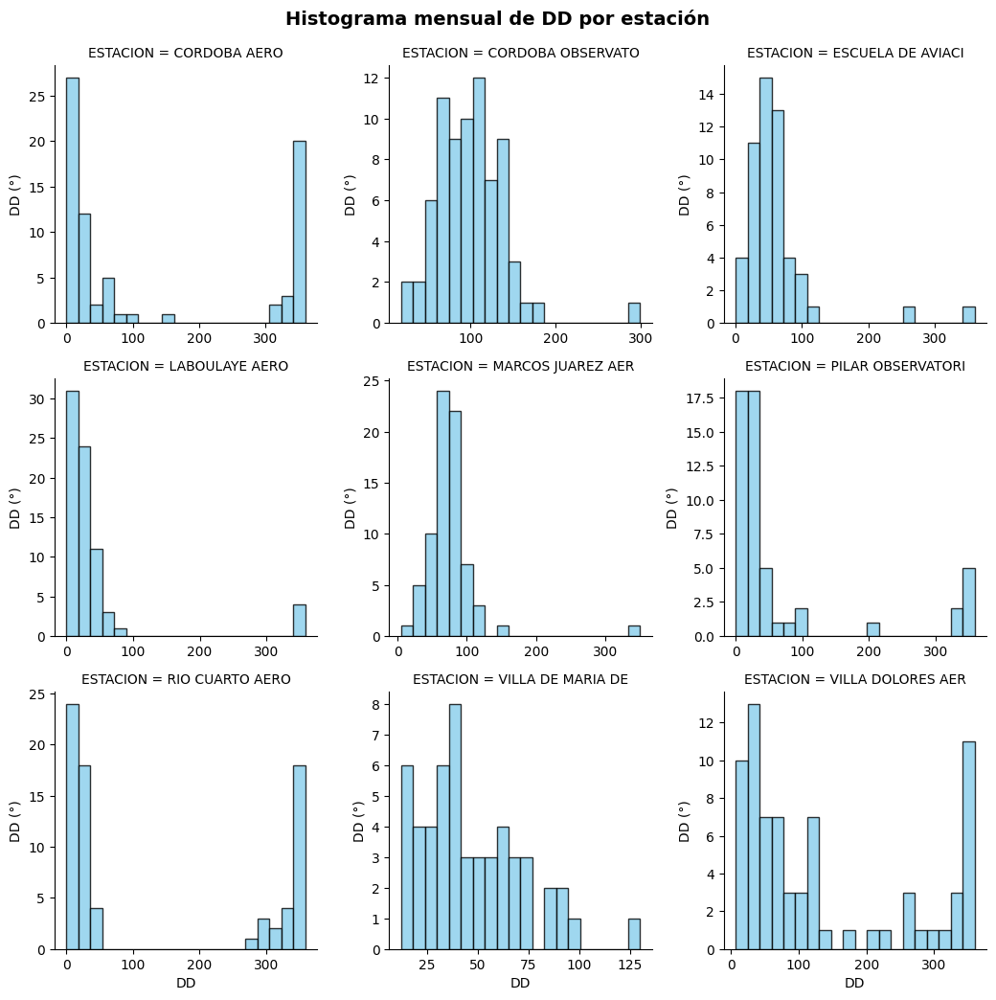

In [ ]:
# =====================
# 2. Histogramas por estación (FacetGrid)
# =====================
for var in variables:
    g = sns.FacetGrid(df_mensual, col="ESTACION", col_wrap=3, height=3.5, sharex=False, sharey=False)
    g.map(plt.hist, var, bins=20, color="skyblue", edgecolor="black", alpha=0.8)

    unidad = unidades.get(var, "")
    titulo = f"Histograma mensual de {var} por estación"

    # Título general (más separado de los títulos de cada subplot)
    g.fig.suptitle(titulo, fontsize=14, weight="bold", y=0.99)

    # Agregar etiqueta del eje y en cada subplot
    for ax in g.axes.flat:
        if unidad:
            ax.set_ylabel(f"{var} ({unidad})")
        else:
            ax.set_ylabel(var)

    plt.tight_layout()
    plt.show()